# Predicting Maternal Health Risks Using Machine Learning

In [1]:
import random
import itertools
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as stats
import matplotlib.pyplot as plt


SEED = 5
random.seed(SEED)

from warnings import filterwarnings

filterwarnings("ignore", category=DeprecationWarning) 
filterwarnings("ignore", category=FutureWarning) 
filterwarnings("ignore", category=UserWarning)

## Loading Data

You can download the dataset from the [UCI ML Repository (Maternal Health Risk)](https://archive.ics.uci.edu/dataset/863/maternal+health+risk). 

**Information:**
Data has been collected from different hospitals, community clinics, maternal health cares from the rural areas of Bangladesh through the IoT based risk monitoring system.

In [2]:
df = pd.read_csv("../data/Maternal Health Risk Data Set.csv")

In [3]:
df.head()

,Age,SystolicBP,DiastolicBP,BS,BodyTemp,HeartRate,RiskLevel
0,25,130,80,15.0,98.0,86,high risk
1,35,140,90,13.0,98.0,70,high risk
2,29,90,70,8.0,100.0,80,high risk
3,30,140,85,7.0,98.0,70,high risk
4,35,120,60,6.1,98.0,76,low risk


In [4]:
df.shape

(1014, 7)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1014 entries, 0 to 1013
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Age          1014 non-null   int64  
 1   SystolicBP   1014 non-null   int64  
 2   DiastolicBP  1014 non-null   int64  
 3   BS           1014 non-null   float64
 4   BodyTemp     1014 non-null   float64
 5   HeartRate    1014 non-null   int64  
 6   RiskLevel    1014 non-null   object 
dtypes: float64(2), int64(4), object(1)
memory usage: 55.6+ KB


In [6]:
df.isnull().sum()

Age            0
SystolicBP     0
DiastolicBP    0
BS             0
BodyTemp       0
HeartRate      0
RiskLevel      0
dtype: int64

| Variable Name | Description  | Units    | 
|---:|:-------------|:-----------|
| Age | Any ages in years when a women during pregnant.  |      |
| SystolicBP | Upper value of Blood Pressure in mmHg, another significant attribute during pregnancy.  |    |
| DiastolicBP | Lower value of Blood Pressure in mmHg, another significant attribute during pregnancy.  |       |
| BS | Blood glucose levels is in terms of a molar concentration  | mmol/L (millimoles per liter)  |
| BodyTemp |  Body temperature   |  F (Fahrenheit)  |
| HeartRate | A normal resting heart rate  |  bpm ( beats per minute) |
| RiskLevel | Predicted Risk Intensity Level during pregnancy considering the previous attribute.  |       |

Note:
- The average body temperature is 98.6 Fahrenheit (37 Celsius). 
- But typical body temperature can range between 97 F (36.1 C) and 99 F (37.2 C) 

In [7]:
df.duplicated().value_counts()

True     562
False    452
Name: count, dtype: int64

More than half of the data values are duplicated. 

In [8]:
duplicated_df = df[df.duplicated()]
duplicated_df

,Age,SystolicBP,DiastolicBP,BS,BodyTemp,HeartRate,RiskLevel
67,19,120,80,7.0,98.0,70,mid risk
72,19,120,80,7.0,98.0,70,mid risk
97,19,120,80,7.0,98.0,70,mid risk
106,50,140,90,15.0,98.0,90,high risk
107,25,140,100,6.8,98.0,80,high risk
...,...,...,...,...,...,...,...
1009,22,120,60,15.0,98.0,80,high risk
1010,55,120,90,18.0,98.0,60,high risk
1011,35,85,60,19.0,98.0,86,high risk
1012,43,120,90,18.0,98.0,70,high risk


In [9]:
df.describe()

,Age,SystolicBP,DiastolicBP,BS,BodyTemp,HeartRate
count,1014.000000,1014.000000,1014.000000,1014.000000,1014.000000,1014.000000
mean,29.871795,113.198225,76.460552,8.725986,98.665089,74.301775
std,13.474386,18.403913,13.885796,3.293532,1.371384,8.088702
min,10.000000,70.000000,49.000000,6.000000,98.000000,7.000000
25%,19.000000,100.000000,65.000000,6.900000,98.000000,70.000000
50%,26.000000,120.000000,80.000000,7.500000,98.000000,76.000000
75%,39.000000,120.000000,90.000000,8.000000,98.000000,80.000000
max,70.000000,160.000000,100.000000,19.000000,103.000000,90.000000


**Statistical description for _Age_ feature:**
- Count: 1014 individuals in the dataset (no missing values).
- Mean: 29.87 years represents the average age of the individuals in the dataset.
- Standard Deviation (std): The ages vary by about 13.47 years from the average, suggesting most ages are between approximately (29.87-13.47) ~ 16 and (29.87+13.47) ~ 44 years.
- Min: The youngest individual is 10 years old.
- Max: The oldest individual is 70 years old.
- 25% (Q1): 25% of the individuals are 19 years old or younger.
- 50% (Median): Half of the individuals are younger than 26, and half are older.
- 75% (Q3): 75% of individuals are 39 years old or younger. 

## Exploratory Data Analysis (EDA)

In [10]:
df1 = df.copy()

In [11]:
# Select only numeric columns (exclude non-numeric ones)
numeric_df = df1.select_dtypes(include=[np.number])

# Check for negative values in numeric columns
has_negative_values = (numeric_df < 0).any().any()

# Find the indices of negative values in numeric columns
negative_indices = np.where(numeric_df < 0)

# Find indices of zeros in the entire DataFrame
zero_indices = np.where(df1 == 0)

# If there are any negative values or zeros
if has_negative_values or np.any(df1 == 0):
    print("Data contains zero and/or negative values.")
    
    # Print indices of negative values
    print(f"Negative values found at indices: {list(zip(negative_indices[0], negative_indices[1]))}")
    
    # Print indices of zero values
    print(f"Indices of zero values: {list(zip(zero_indices[0], zero_indices[1]))}")
else:
    print("There are no zero and negative values in the dataset.")

There are no zero and negative values in the dataset.


### Univariate Analysis 

In [12]:
def plot_univariate(data, feature):
    """
    Plots a univariate analysis of a feature using a histogram with KDE and a boxplot.
    
    Parameters:
    - data: pandas DataFrame, the dataset containing the feature.
    - feature: str, the feature (column) to analyze in the dataset.
    """
    
    # Create a figure with a specific size for the subplots
    fig = plt.figure(figsize=(12, 8))  
    
    # --------------- Histogram with KDE Plot ---------------
    # Create a subplot for the histogram with Kernel Density Estimation (KDE)
    plt.subplot(2, 2, 1)
    sns.histplot(data=data, x=feature, kde=True)  
    plt.title(f"Histogram with KDE of '{feature}'")  
    plt.xlabel(feature)  
    plt.ylabel('Frequency')  
    
    # --------------- Boxplot Plot ---------------
    # Create a subplot for the boxplot
    plt.subplot(2, 2, 2)
    sns.boxplot(data=data, x=feature)  
    plt.title(f"Boxplot of '{feature}'")  
    plt.xlabel(feature)  # Label the x-axis
    
    plt.tight_layout()
    plt.show()



def plot_target_distribution(data, column):
    """
    Creates a bar plot showing the distribution of quality classes in the dataset.
    
    Parameters:
    - data: pandas DataFrame containing the data.
    - column: str, the name of the column to analyze .
    """
    plt.figure(figsize=(8, 5))
    palette = sns.color_palette("viridis", n_colors=len(data[column].unique()))
    ax = sns.countplot(x=column, data=data, palette=palette)

    # Calculate total counts
    total_counts = len(data)

    # Annotate percentages on the bars
    for p in ax.patches:
        percentage = (p.get_height() / total_counts) * 100
        ax.annotate(f'{p.get_height()} ({percentage:.2f}%)', 
                    (p.get_x() + p.get_width() / 2, p.get_height()), 
                    ha='center', va='bottom')

    plt.title(f'Distribution Plot of {column}')
    plt.ylabel('Count')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

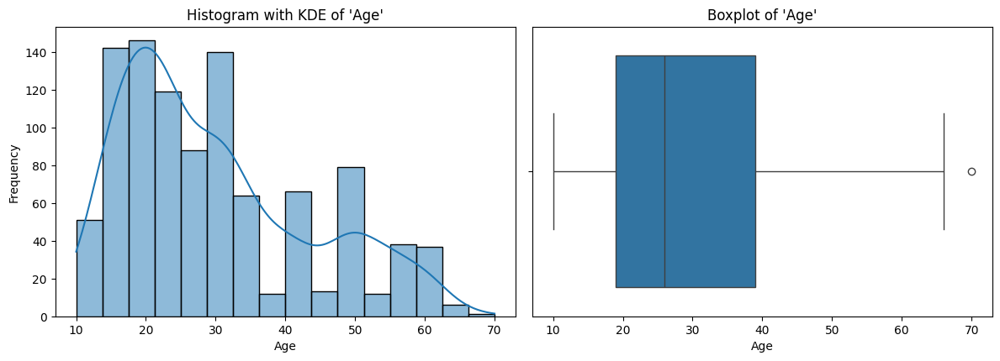

In [13]:
plot_univariate(df1, "Age")

- The distribution of 'Age' is not normally distributed.
- Why can the youngest woman be 10 years old?
- Why is this older individual, at the age of 70, considered an outlier? 

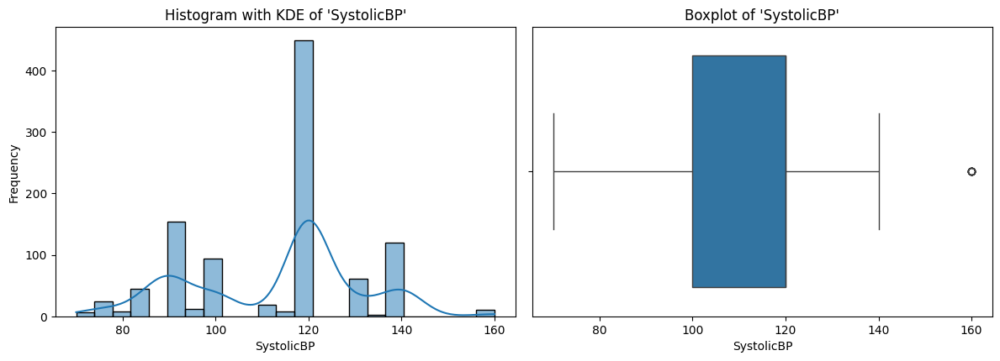

In [14]:
plot_univariate(df1, "SystolicBP")

An individual with a high value of blood pressure is considered aberrant.

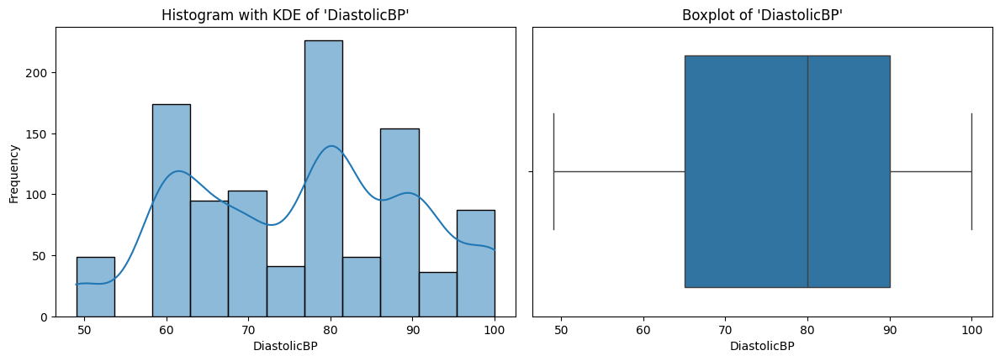

In [15]:
plot_univariate(df1, "DiastolicBP")

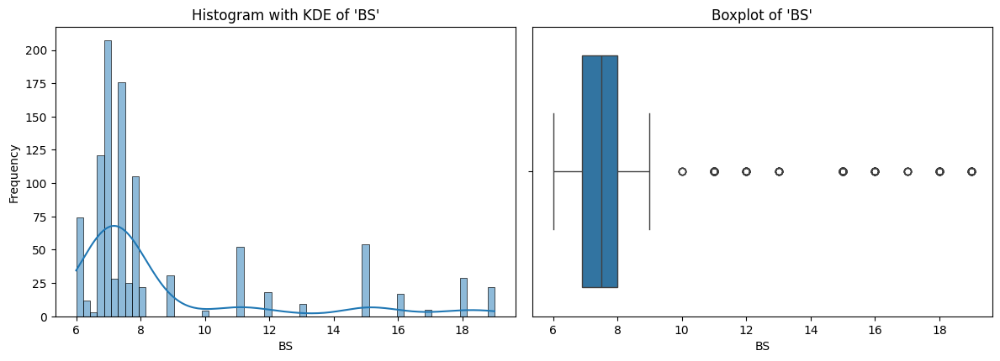

In [16]:
plot_univariate(df1, "BS")

In terms of blood glucose levels, many people are considered aberrant.

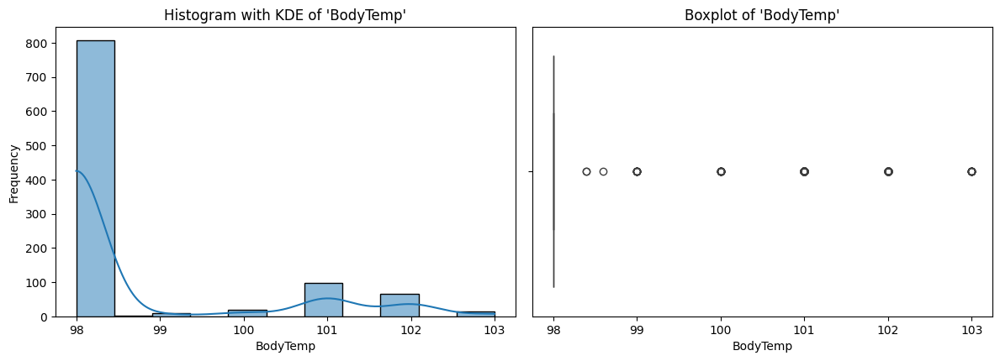

In [17]:
plot_univariate(df1, "BodyTemp")

In terms of body temperature, many people are considered aberrant. 

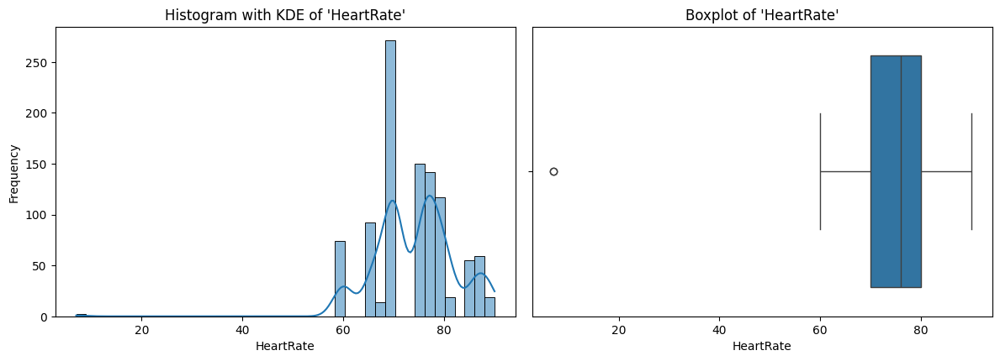

In [18]:
plot_univariate(df1, "HeartRate")

If one person has an aberrant heart rate, it should be investigated to understand the cause. 

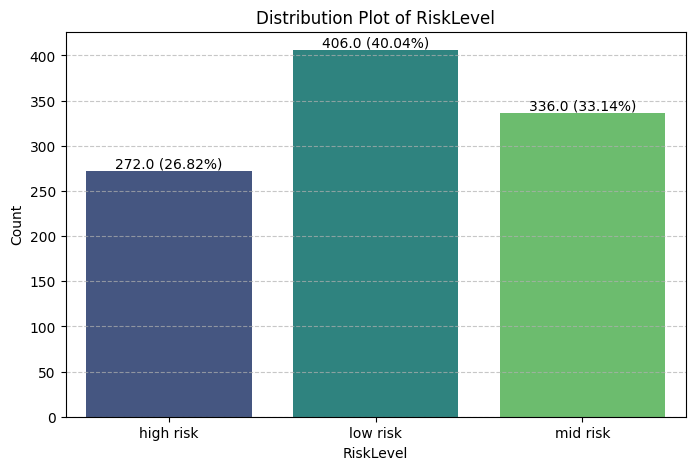

In [19]:
plot_target_distribution(df1, "RiskLevel")

More people have a low risk of becoming sick. This number decreases slowly as the risk level increases.

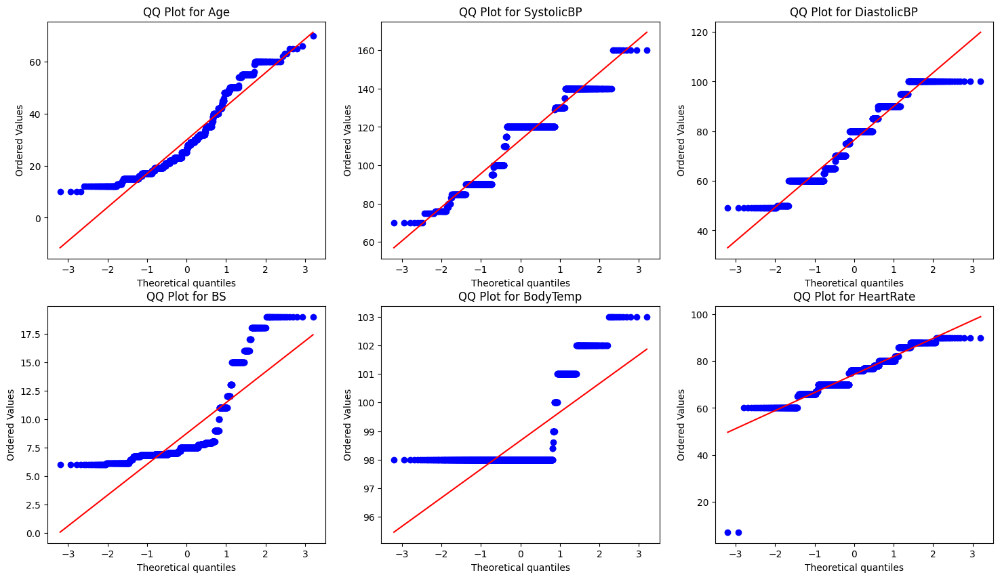

In [20]:
# Create a list of features excluding the specified feature
features_to_plot = [col for col in df1.iloc[:, :-1].columns]

# Create a figure
plt.figure(figsize=(18, 10))

# Loop over the features and create a QQ plot for each
for i, feature in enumerate(features_to_plot):
    # Determine the subplot index (i + 1 because indices in subplot start from 1)
    plt.subplot(2, 3, i + 1)

    # Generate the QQ plot
    stats.probplot(df1[feature], dist="norm", plot=plt)
    plt.title(f'QQ Plot for {feature}')

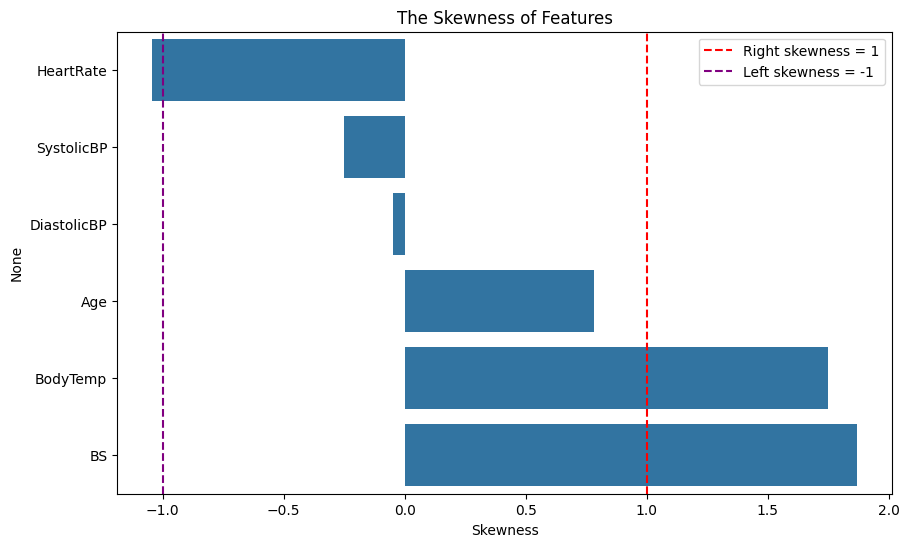

In [21]:
# Calculate skewness of each feature
skewness = df1.iloc[:, :-1].skew().sort_values()

# Create the bar plot
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=skewness, y=skewness.index)

# Set the title and labels
ax.set_title('The Skewness of Features')
ax.set_xlabel('Skewness')

# Add vertical lines at skewness thresholds of -1 and 1
plt.axvline(x=1, color='r', linestyle='--', label='Right skewness = 1')
plt.axvline(x=-1, color='purple', linestyle='--', label='Left skewness = -1')

# Add legend for vertical lines
plt.legend();

There are three variables with **higher skewness**: **HeartRate**, **BodyTemp**, and **BS**. 

**Key Points in Univariate Analysis:**

- **Age Distribution**: **Age** is **not normally distributed**, with **extreme values** like **10-year-olds** or **70-year-olds** possibly being outliers.
- **Outliers**: High blood pressure, unusual blood glucose, and body temperature values are outliers.
- **Heart Rate**: Abnormal heart rates need further investigation.
- **Risk Levels**: **Most** people are at **low risk**, with **fewer** at **higher risk** levels.
- **Skewness**: **HeartRate**, **BodyTemp**, and **BS** have higher skewness.


### Bivariate Analysis 

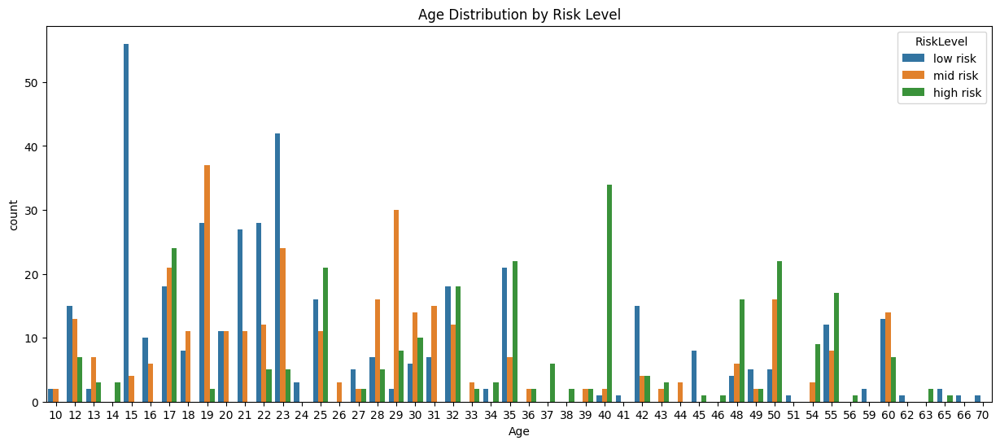

In [22]:
fig = plt.figure(figsize=(15, 6))
sns.countplot(data=df1, x="Age", hue="RiskLevel")
plt.title("Age Distribution by Risk Level");

Can a 10-year-old girl be a women? 

In [23]:
def get_people_by_age_category(data):
    bins = [0, 15, 65, np.inf]
    labels = ['0-14', '15-64', '>=65']
    data["AgeGroup"] = pd.cut(x=data['Age'], bins=bins, labels=labels)
    return data

# Call function
df1 = get_people_by_age_category(df1)

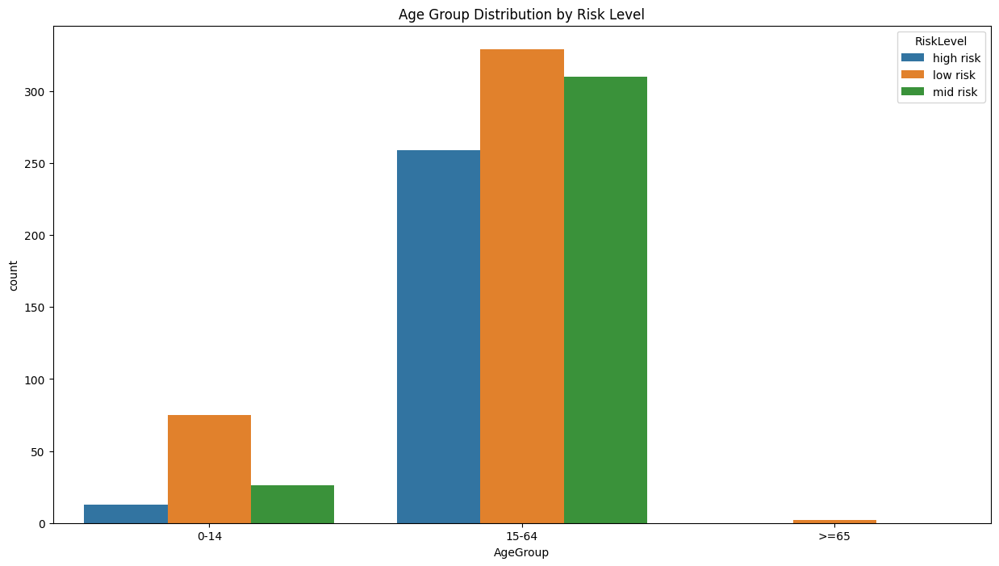

In [24]:
# Plotting
fig = plt.figure(figsize=(15, 8))
sns.countplot(data=df1, x="AgeGroup", hue="RiskLevel")
plt.title("Age Group Distribution by Risk Level");

- For younger girl, the majority have a low risk of becoming sick.
- For women, slightly more of them have a low risk than a mild risk. The majority have a low risk of becoming sick rather than a high risk.
- Older women have a low risk of becoming sick. 

In [25]:
# The blood pressure categories are defined here: 
# https://www.health.harvard.edu/heart-health/reading-the-new-blood-pressure-guidelines

def get_people_by_sbp_category(data):
    bins = [0, 120, 129, 139, 179, np.inf]
    labels = ['Nornal', 'Elevated', 'High_1', 'High_2', 'Crisis']
    data["SystolicBPGroup"] = pd.cut(x=data['SystolicBP'], bins=bins, labels=labels)
    return data



df1 = get_people_by_sbp_category(df1)

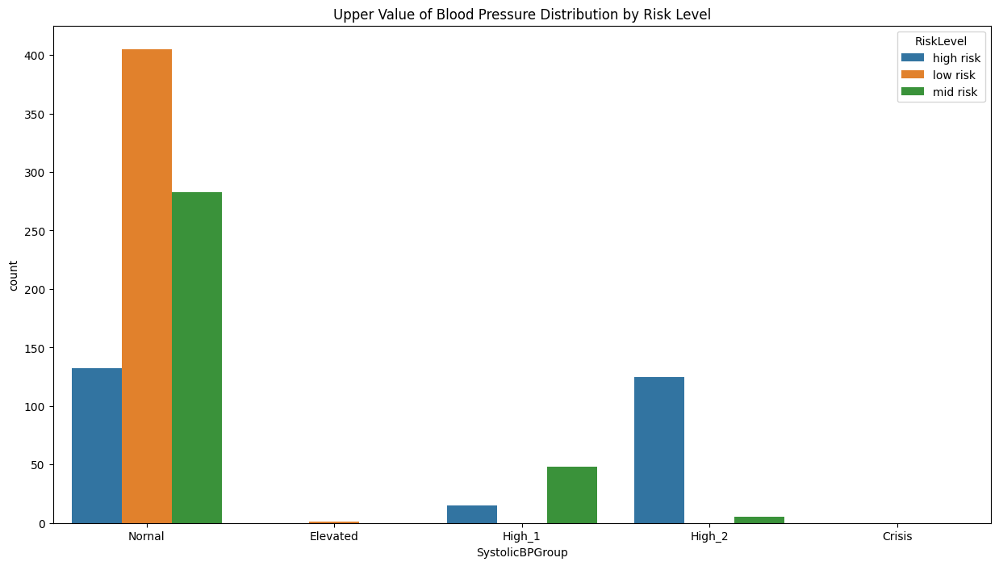

In [26]:
fig = plt.figure(figsize=(15, 8))
sns.countplot(data=df1, x="SystolicBPGroup", hue="RiskLevel")
plt.title("Upper Value of Blood Pressure Distribution by Risk Level");

**Women with upper value of Blood Pressure:**
- The majority of people with normal blood pressure have a low risk of becoming sick compared to mild and high risk.
- A few people with elevated blood pressure have a low risk.
- For people in stage 1 hypertension, the number of mild risks is higher than the number of high risks, but there are no low risks.
- For people in stage 2 hypertension, the number of high risks is higher than the number of mild risks, but there are no low risks.
- No one should consult a doctor immediately.

In [27]:
# The blood pressure categories are defined here: 
# https://www.health.harvard.edu/heart-health/reading-the-new-blood-pressure-guidelines

def get_people_by_dbp_category(data):
    bins = [0, 80, 80.01, 89, 119, np.inf]
    labels = ['Nornal', 'Elevated', 'High_1', 'High_2', 'Crisis']
    data["DiastolicBPGroup"] = pd.cut(x=data['DiastolicBP'], bins=bins, labels=labels)
    return data


df1 = get_people_by_dbp_category(df1)

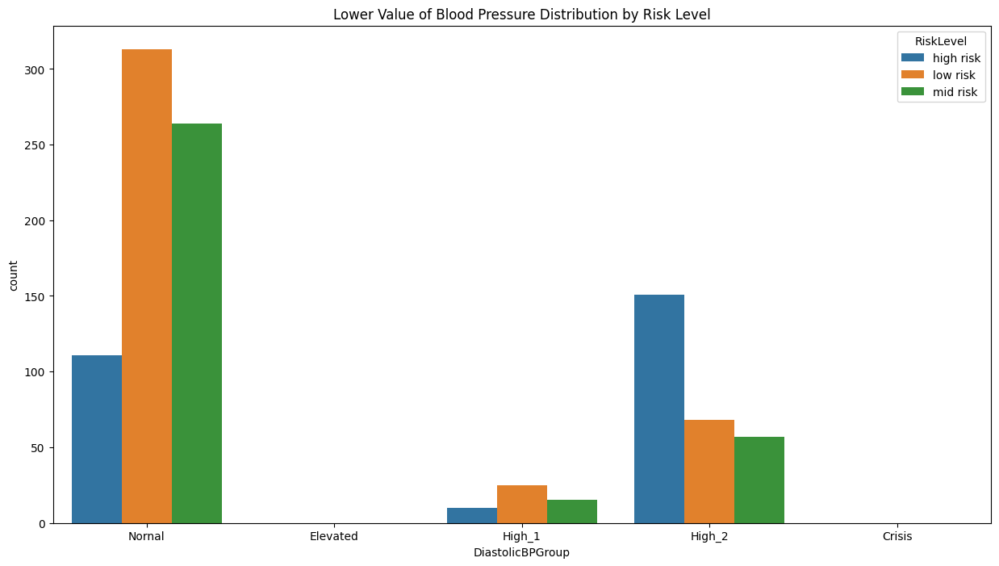

In [28]:
fig = plt.figure(figsize=(15, 8))
sns.countplot(data=df1, x="DiastolicBPGroup", hue="RiskLevel")
plt.title("Lower Value of Blood Pressure Distribution by Risk Level");

**Women with lower value of Blood Pressure:**
- The majority of people with normal blood pressure have a low risk of becoming sick compared to mild and high risk.
- No one have elevated blood pressure.
- For people in stage 1 hypertension, the number of low risks is higher than the number of mild and then high risks.
- For people in stage 2 hypertension, the number of high risks is important than the number of low and mild risks.
- No one should consult a doctor immediately. 

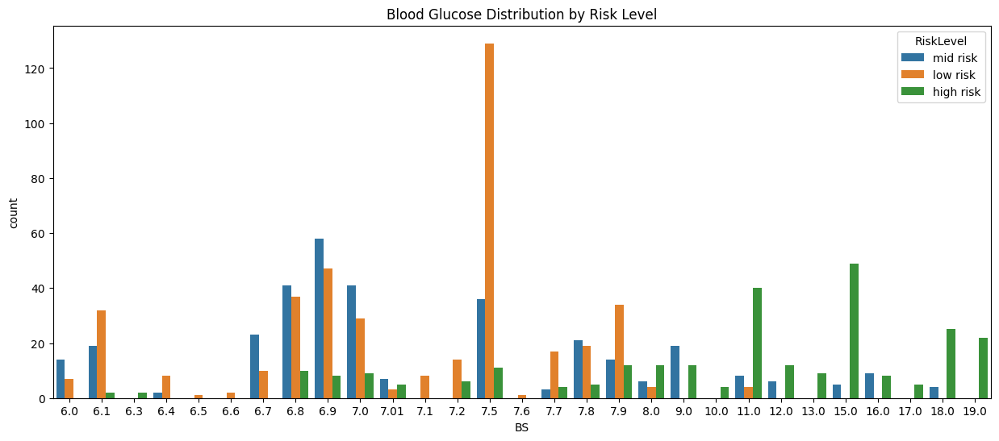

In [29]:
fig = plt.figure(figsize=(15, 6))
sns.countplot(data=df1, x="BS", hue="RiskLevel")
plt.title("Blood Glucose Distribution by Risk Level");

We use the blood glucose threshold from the [Mayo Clinic](https://www.mayoclinic.org/diseases-conditions/prediabetes/diagnosis-treatment/drc-20355284) website.

- Less than 140 mg/dL (7.8 mmol/L) is normal
- 140 to 199 mg/dL (7.8 to 11.0 mmol/L) is consistent with prediabetes
- 200 mg/dL (11.1 mmol/L) or higher after two hours suggests diabetes

In [30]:
def get_people_by_bs_category(data):
    bins = [0, 7.9, 11.1, np.inf]
    labels = ['Nornal<7.8', '7.8<=Prediabetes<=11.0', '11.1>=Diabetes']
    data["BSGroup"] = pd.cut(x=data['BS'], bins=bins, labels=labels)
    return data


df1 = get_people_by_bs_category(df1)

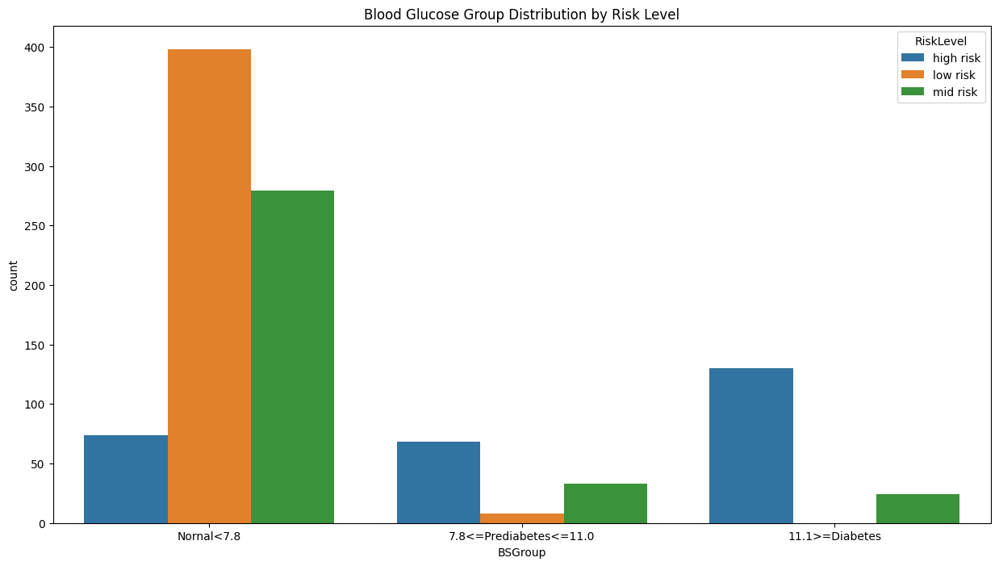

In [31]:
fig = plt.figure(figsize=(15, 8))
sns.countplot(data=df1, x="BSGroup", hue="RiskLevel")
plt.title("Blood Glucose Group Distribution by Risk Level");

- The majority of people without diabetes have a low risk of developing sickness. Additionally, more people have a mild risk, but a considerable number have a high risk.
- For people with prediabetes, more of them have a high risk than have a mild or low risk.
- For people with diabetes, more have mild risk than high risk.

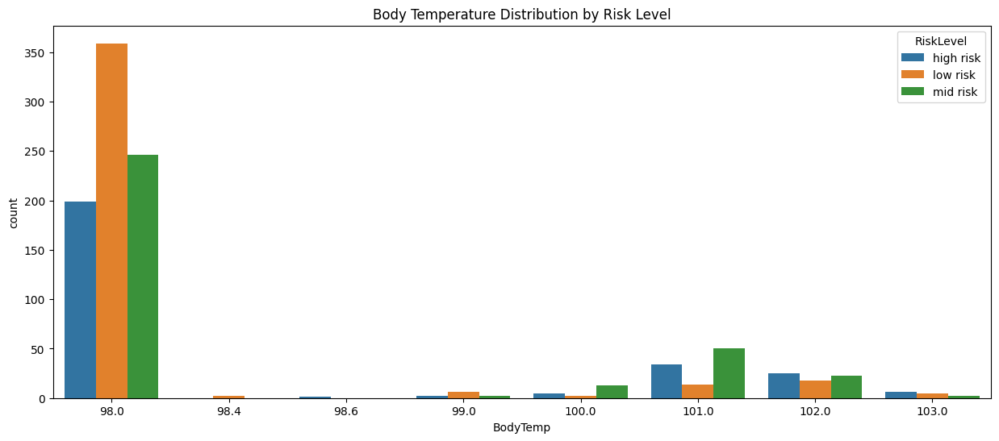

In [32]:
fig = plt.figure(figsize=(15, 6))
sns.countplot(data=df1, x="BodyTemp", hue="RiskLevel")
plt.title("Body Temperature Distribution by Risk Level");

In [33]:
# https://www.medicalnewstoday.com/articles/323819

def get_people_by_bt_category(data):
    bins = [0, 96.0, 99.5, np.inf]  
    labels = ['Hypothermic (<96°F)', 'Normal (96.0°F - 99.5°F)', 'Fever (>99.5°F)']  
    
    data["BodyTempGroup"] = pd.cut(x=data['BodyTemp'], bins=bins, labels=labels)
    return data


df1 = get_people_by_bt_category(df1)

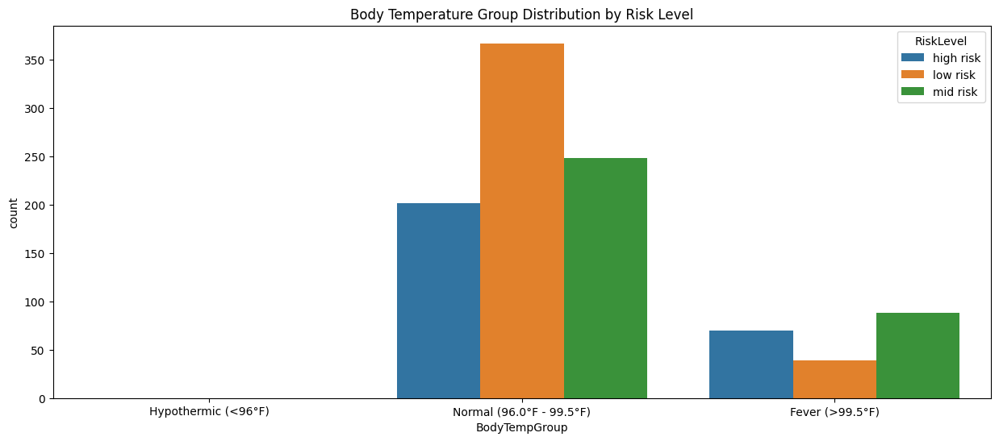

In [34]:
fig = plt.figure(figsize=(15, 6))
sns.countplot(data=df1, x="BodyTempGroup", hue="RiskLevel")
plt.title("Body Temperature Group Distribution by Risk Level");

- The majority of people with a normal body temperature have a low risk of developing sickness, followed by a considerable number with mild risk, and then a significant portion with high risk.
- For people with a higher body temperature, we have almost the same number with mild and high risk, and only a few have low risk.
- No one has a temperature below normal.

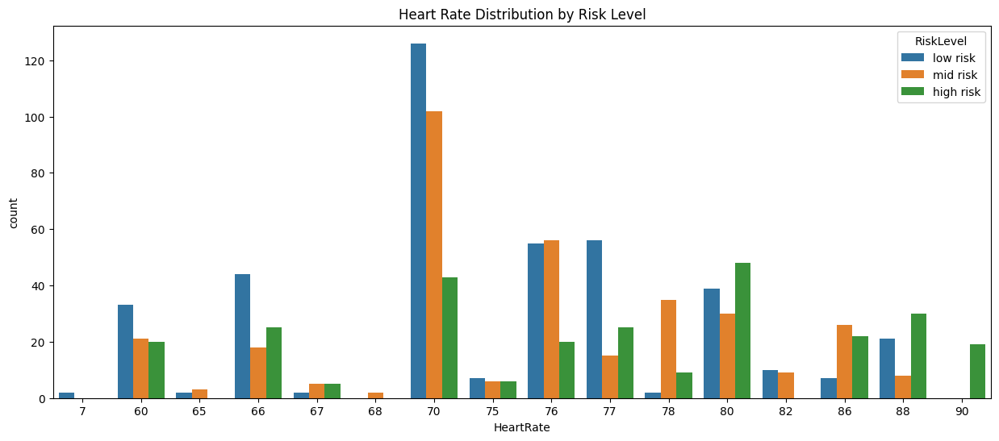

In [35]:
fig = plt.figure(figsize=(15, 6))
sns.countplot(data=df1, x="HeartRate", hue="RiskLevel")
plt.title("Heart Rate Distribution by Risk Level");

Since a normal resting heart rate ranges from 60 to 100 beats per minute, this women with an abnormal heart rate (7) is considered aberrant and should be investigated.

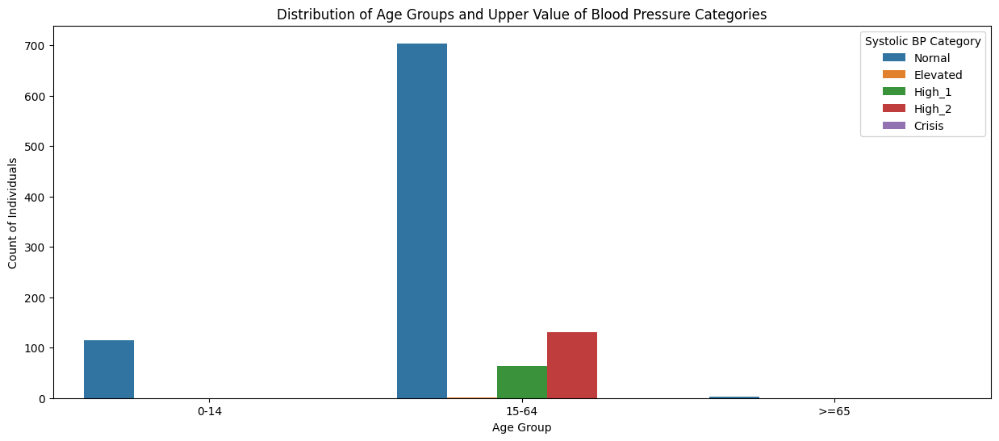

In [36]:
plt.figure(figsize=(15, 6))
sns.countplot(data=df1, x="AgeGroup", hue="SystolicBPGroup")

# Adding labels and title
plt.title('Distribution of Age Groups and Upper Value of Blood Pressure Categories')
plt.xlabel('Age Group')
plt.ylabel('Count of Individuals')
plt.legend(title='Systolic BP Category');

- Women with a normal lower value of blood pressure are more numerous than girls and older women.
- A considerable number of women have stage 2 hypertension. 

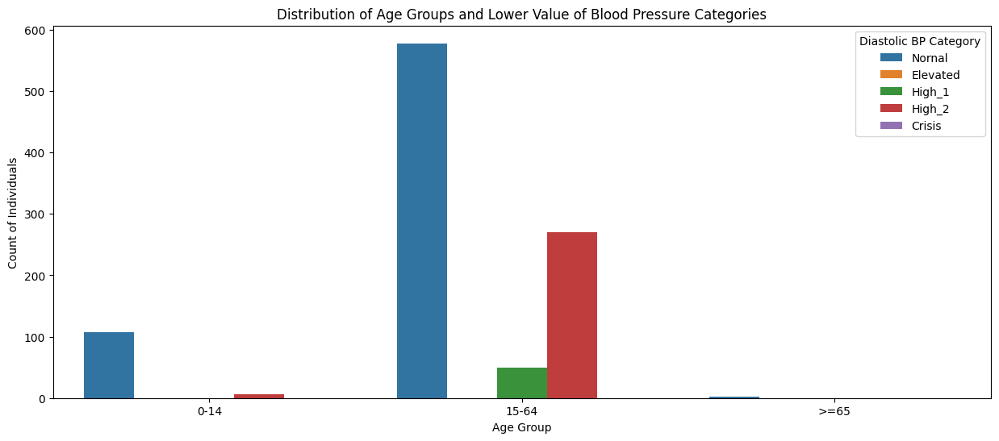

In [37]:
plt.figure(figsize=(15, 6))
sns.countplot(data=df1, x="AgeGroup", hue="DiastolicBPGroup")

# Adding labels and title
plt.title('Distribution of Age Groups and Lower Value of Blood Pressure Categories')
plt.xlabel('Age Group')
plt.ylabel('Count of Individuals')
plt.legend(title='Diastolic BP Category');

- Women with a normal lower value of blood pressure are more numerous than girls and older women.
- More women have stage 2 hypertension than girls.

**Key Points in Bivariate Analysis:**

- **Younger girls** and **older women** generally exhibit a **low risk** of illness. 
    - Therefore, in the preprocessing step, we could map the label into two categories instead of three.
- **Women**, in general, tend to have a **low risk**, although **stage 2 hypertension** is more common among them.
- **Normal blood pressure** is associated with a **low risk**, whereas **elevated blood pressure** and **hypertension** are linked to **higher risks** (**mild to high**).
- **Diabetes** and **prediabetes** increase the likelihood of experiencing higher health risks.
- **Normal body temperature** is typically associated with a low risk, while fever often correlates with **mild or high risks**.
- **Abnormal heart rates** should prompt further investigation.
- No immediate consultation with a doctor is necessary unless symptoms are severe or concerning.

### Multivariate Analysis

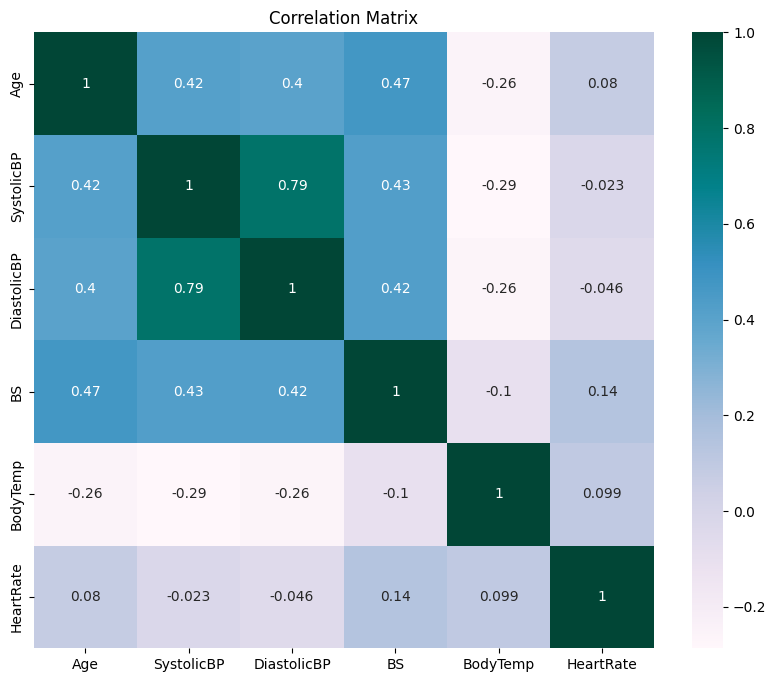

In [38]:
plt.figure(figsize = (10,8))
# Drop the last column in the dataset and plot the correlation matrix
sns.heatmap(df1.iloc[:, :-6].corr(),annot=True, cmap= 'PuBuGn')
plt.title('Correlation Matrix');

SystolicBP and DiastolicBP are highly correlated. 

We can see that the upper and lower blood pressure values are highly correlated. This will be considered when building the model.

#### Hypothesis testing

- **Null Hypothesis** (**$H_0$**): No relationship or difference between the variables/groups.
- **Alternative Hypothesis** (**$H_1$**): There is a significant relationship or difference.
- **Outcome**: Based on the p-value ($p$) and significance level ($\alpha$):
    - If $p \leq \alpha$: Reject **$H_0$**. The results are unlikely due to chance, suggesting evidence for **$H_1$**.
    - If $p \geq \alpha$: Fail to reject **$H_0$**. The results are consistent with **$H_0$**, and there’s insufficient evidence for **$H_1$**.

In [39]:
def get_pearsonr_test(data, alpha=0.05):
    # Get a list of all column names, excluding the string columns
    features = data.columns[:-6]
    
    # Iterate over all unique pairs of features
    for var1, var2 in itertools.combinations(features, 2):
        try:
            # Perform Pearson's correlation test
            result = stats.pearsonr(data[var1], data[var2])
            
            if result is not None:
                corr_coefficient, pvalue = result
                print(f"\nPearson's Correlation Test between '{var1}' and '{var2}'.\n")
                print(f"Correlation coefficient (r) : {corr_coefficient}")
                print(f"P-value : {pvalue}")
                # Decision
                if pvalue <= alpha:
                    decision = "Reject"
                    conclusion = f"We have sufficient evidence to say there is a significant linear relationship between {var1} and {var2}."
                    print(f"Decision : {decision} the null hypothesis at alpha = {alpha}.")
                    print(f"Conclusion: {conclusion}")
                else:
                    decision = "Fail to reject"
                    conclusion = f"We have insufficient evidence to claim a significant linear relationship between {var1} and {var2}."
                    print(f"Decision : {decision} the null hypothesis at alpha = {alpha}.")
                    print(f"Conclusion: {conclusion}") 
        
        except Exception as e:
            print(f"Error calculating correlation for {var1} and {var2}: {e}")
    

In [40]:
get_pearsonr_test(df1, alpha=0.05)


Pearson's Correlation Test between 'Age' and 'SystolicBP'.

Correlation coefficient (r) : 0.416045447974733
P-value : 1.025502775259973e-43
Decision : Reject the null hypothesis at alpha = 0.05.
Conclusion: We have sufficient evidence to say there is a significant linear relationship between Age and SystolicBP.

Pearson's Correlation Test between 'Age' and 'DiastolicBP'.

Correlation coefficient (r) : 0.398026286703184
P-value : 7.835631748556726e-40
Decision : Reject the null hypothesis at alpha = 0.05.
Conclusion: We have sufficient evidence to say there is a significant linear relationship between Age and DiastolicBP.

Pearson's Correlation Test between 'Age' and 'BS'.

Correlation coefficient (r) : 0.47328433592916763
P-value : 9.845293145035706e-58
Decision : Reject the null hypothesis at alpha = 0.05.
Conclusion: We have sufficient evidence to say there is a significant linear relationship between Age and BS.

Pearson's Correlation Test between 'Age' and 'BodyTemp'.

Correlation

Since our **data** is **not normally distributed**, we will perform the **Kruskal-Wallis** test (a non-parametric alternative to ANOVA)


-  **Null Hypothesis** (**$H_0$**): The median is the same for all the data groups.
- **Alternative Hypothesis** (**$H_1$**): The median is not equal for all the data groups.

In [41]:
def get_kruskal_wallis_test(data, alpha=0.05):
    # Perform Kruskal-Wallis H-test
    hvalue, pvalue = stats.kruskal(data['Age'],
                                    data['SystolicBP'], 
                                    data['DiastolicBP'], 
                                    data['BS'], 
                                    data['BodyTemp'], 
                                    data['HeartRate'])
    
    # Decision
    if pvalue <= alpha:
        decision = "Reject"
    else:
        decision = "Fail to reject"
    
    # Conclusion
    if decision == "Reject":
        conclusion = "We have sufficient evidence to say there is a significant difference in the medians between the variables."
    else:
        conclusion = "We have insufficient evidence to claim a significant difference in the medians between the variables."
        
    # Display results
    print(f"Kruskal-Wallis test (H-test) on 'Age', 'SystolicBP', 'DiastolicBP', 'BS', 'BodyTemp', and 'HeartRate' variables.\n")
    print(f"H-value : {hvalue}")
    print(f"P-value : {pvalue}")
    print(f"Decision : {decision} the null hypothesis at alpha = {alpha}.")
    print(f"Conclusion: {conclusion}")


In [42]:
get_kruskal_wallis_test(df1, alpha=0.05)

Kruskal-Wallis test (H-test) on 'Age', 'SystolicBP', 'DiastolicBP', 'BS', 'BodyTemp', and 'HeartRate' variables.

H-value : 5392.012689062833
P-value : 0.0
Decision : Reject the null hypothesis at alpha = 0.05.
Conclusion: We have sufficient evidence to say there is a significant difference in the medians between the variables.


## Preprocessing

In [43]:
df2 = df.copy()

#### Data Cleaning

**Reason for Not Dropping Duplicates:**

- The significant correlations between variables suggest that duplicates are likely real, repeated measurements, not mistakes. 
- Since the data comes from different health facilities, keeping the duplicates helps preserve important information about patient health trends and the system's behavior.

**Reason for Not Handling Outliers:**

- **Real-world variability**: The data comes from different health facilities, each with its own patient population and practices. What seems like an outlier in one place could actually be a rare but real health event.
- **Reflecting healthcare diversity**: Outliers might represent important or rare health conditions that are useful for understanding less common health outcomes. Keeping them helps the model better reflect the diversity of patients and healthcare settings.

In [44]:
# Drop one of the high correlated feature
# df2.drop(["DiastolicBP"], axis=1, inplace=True)

#### Handle Skewness

We will apply a function to handle skewness when splitting the data, but only on the training set, to avoid data leakage.

#### Feature Engineering

In [45]:
# Map the original categories to new categories
df2['RiskLevel'] = df2['RiskLevel'].map({'high risk': 'elevated risk', 
                                         'mid risk': 'elevated risk',
                                         'low risk': 'low risk'})

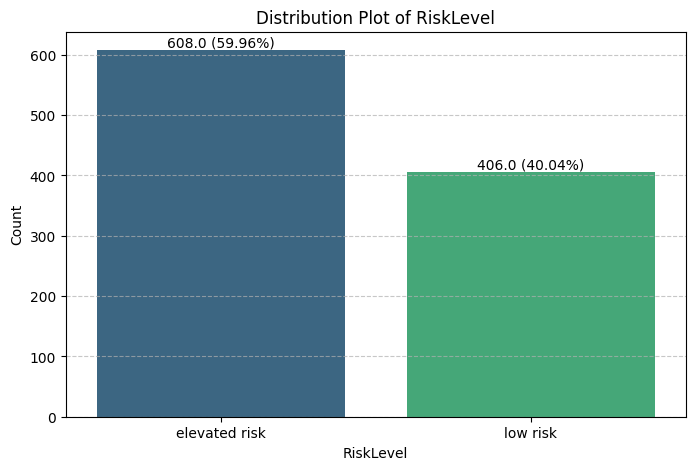

In [46]:
plot_target_distribution(df2, "RiskLevel")

#### Data Splitting

- Since our labels are ordinal (low < mild < high), we will apply Label Encoding.
- Since our dataset is not normally distributed, we can use either MinMaxScaler or RobustScaler.


Check this : [https://stackoverflow.com/questions/13610074/is-there-a-rule-of-thumb-for-how-to-divide-a-dataset-into-training-and-validatio](https://stackoverflow.com/questions/13610074/is-there-a-rule-of-thumb-for-how-to-divide-a-dataset-into-training-and-validatio)

In [6]:
# from tabgan.sampler import GANGenerator
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from imblearn.under_sampling import RandomUnderSampler
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from sklearn.preprocessing import PowerTransformer, FunctionTransformer

In [ ]:
# Function to check for constant columns
def check_constant_columns(data):
    constant_columns = data.columns[data.nunique() <= 1]
    return constant_columns

# Apply transformations function
def apply_transformations(X_train, X_valid, X_test, transform_method, transform_columns=None):
    """
    Apply various transformations to specific columns in the dataset (X_train, X_valid, X_test).
    """
    # Ensure we are working with copies of the original datasets
    X_train_transformed = X_train.copy()
    X_valid_transformed = X_valid.copy()
    X_test_transformed = X_test.copy()

    # If no columns are specified, transform all columns except the target column
    if transform_columns is None:
        transform_columns = X_train.columns

    # Check for constant columns and exclude them
    constant_columns = check_constant_columns(X_train_transformed[transform_columns])
    transform_columns = [col for col in transform_columns if col not in constant_columns]

    # Define the transformation functions
    transformations = {
        "log": lambda X: np.log(X),
        "reciprocal": lambda X: 1 / X,
        "square": lambda X: np.square(X),
        "sqrt": lambda X: np.sqrt(X),
        "custom": lambda X: np.power(X, 3),
    }

    # Apply the transformation methods
    if isinstance(transform_method, str):
        transform_method = [transform_method]  # If a single method is passed, make it a list

    for method in transform_method:
        if method not in transformations and method != "box-cox" and method != "yeo-johnson":
            raise ValueError(f"Unknown transformation method: {method}. Available methods: 'log', 'reciprocal', 'square', 'sqrt', 'custom', 'box-cox', 'yeo-johnson'.")

        if method in transformations:
            # Apply simple transformations
            transformer = FunctionTransformer(transformations[method], validate=True)
            X_train_transformed[transform_columns] = transformer.fit_transform(X_train_transformed[transform_columns])
            X_valid_transformed[transform_columns] = transformer.transform(X_valid_transformed[transform_columns])
            X_test_transformed[transform_columns] = transformer.transform(X_test_transformed[transform_columns])

        elif method == "box-cox":
            # Box-Cox transformation requires all positive values
            if (X_train_transformed[transform_columns] <= 0).any().any():
                raise ValueError(f"Box-Cox transformation requires all positive values in columns {transform_columns}.")
            power_transformer = PowerTransformer(method='box-cox', standardize=False)
            X_train_transformed[transform_columns] = power_transformer.fit_transform(X_train_transformed[transform_columns])
            X_valid_transformed[transform_columns] = power_transformer.transform(X_valid_transformed[transform_columns])
            X_test_transformed[transform_columns] = power_transformer.transform(X_test_transformed[transform_columns])

        elif method == "yeo-johnson":
            # Yeo-Johnson transformation can handle both positive and negative values
            power_transformer = PowerTransformer(method='yeo-johnson', standardize=False)
            X_train_transformed[transform_columns] = power_transformer.fit_transform(X_train_transformed[transform_columns])
            X_valid_transformed[transform_columns] = power_transformer.transform(X_valid_transformed[transform_columns])
            X_test_transformed[transform_columns] = power_transformer.transform(X_test_transformed[transform_columns])

    return X_train_transformed, X_valid_transformed, X_test_transformed

In [49]:
def apply_resampling(X_train, y_train, resample_method="OVER", random_state=SEED):
    """
    Applies the selected resampling technique to the training set after encoding the target labels.
    Optionally, you can choose not to apply any resampling.

    Parameters:
    - X_train: pandas DataFrame or numpy array, training features.
    - y_train: pandas Series or numpy array, training target labels.
    - resample_method: str, method to use for resampling. Options: "OVER", "UNDER", "NONE".
    - random_state: int, random state for reproducibility.

    Returns:
    - X_train_resampled: Resampled feature set (or original if no resampling).
    - y_train_resampled: Resampled target labels (or original if no resampling).
    - label_encoder: LabelEncoder object used to encode the labels.
    """
    # Apply LabelEncoder to the target variable
    label_encoder = LabelEncoder()
    y_train_encoded = label_encoder.fit_transform(y_train)
    
    # Ensure both X_train and y_train have the same number of samples
    assert X_train.shape[0] == y_train_encoded.shape[0], "Mismatch in number of samples between X_train and y_train_encoded"


    # Apply resampling if required
    if resample_method == "OVER":
        # Apply SMOTE for oversampling
        smote = SMOTE(random_state=random_state)
        X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train_encoded)
    elif resample_method == "UNDER":
        # Apply RandomUnderSampler for undersampling
        rus = RandomUnderSampler(random_state=random_state)
        X_train_resampled, y_train_resampled = rus.fit_resample(X_train, y_train_encoded)
    elif resample_method == "NONE":
        # No resampling, just return the original data
        X_train_resampled, y_train_resampled = X_train, y_train_encoded
    else:
        raise ValueError("Invalid resample_method. Choose from ['OVER', 'UNDER', 'NONE']")

    return X_train_resampled, y_train_resampled, label_encoder


In [50]:
def scale_data(X_train, X_valid, X_test, scaler_type="minmax"):
    """
    Scales the features using the specified scaler (MinMaxScaler or RobustScaler).

    Parameters:
    - X_train: pandas DataFrame or numpy array, training features.
    - X_valid: pandas DataFrame or numpy array, validation features.
    - X_test: pandas DataFrame or numpy array, test features.
    - scaler_type: str, one of "minmax" or "robust" to specify the scaler to use.

    Returns:
    - X_train_scaled, X_valid_scaled, X_test_scaled: Scaled features for training, validation, and test sets.
    """
    if scaler_type == "minmax":
        scaler = MinMaxScaler()
    elif scaler_type == "robust":
        scaler = RobustScaler()
    else:
        raise ValueError("Invalid scaler type. Choose 'minmax' or 'robust'.")

    # Fit the scaler on the training data and transform the datasets
    X_train_scaled = scaler.fit_transform(X_train)
    X_valid_scaled = scaler.transform(X_valid)
    X_test_scaled = scaler.transform(X_test)

    return X_train_scaled, X_valid_scaled, X_test_scaled


In [51]:
# Split the data into features (X) and target (y)
X = df2.drop(columns=["RiskLevel"])
y = df2["RiskLevel"]

# Split the data into training - validation and testing sets
X_train_valid, X_test, y_train_valid, y_test = train_test_split(X, y, test_size=0.15, random_state=SEED)

# Split the training+validation set into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X_train_valid, y_train_valid, test_size=0.1, random_state=SEED)


# Apply Transformation 
X_train_transformed, X_valid_transformed, X_test_transformed = apply_transformations(
    X_train, X_valid, X_test,
    transform_method="yeo-johnson",  # "log", "reciprocal", "square", "sqrt", "custom", "box-cox", "yeo-johnson".
    transform_columns=["HeartRate", "BodyTemp", "BS"] 
)

# Apply Resampling
X_train_resampled, y_train_encoded, label_encoder = apply_resampling(
    X_train_transformed, y_train, 
    resample_method="OVER",  # or "OVER" or "UNDER" or "NONE"
    random_state=SEED
)


### Apply Scaler

# Using MinMaxScaler:
X_train_scaled, X_valid_scaled, X_test_scaled = scale_data(
    X_train_resampled, X_valid_transformed, X_test_transformed, scaler_type="minmax"
)

# # Using RobustScaler:
# X_train_scaled, X_valid_scaled, X_test_scaled = scale_data(
#     X_train_resampled, X_valid_transformed, X_test_transformed, scaler_type="robust"
# )


# Apply LabelEncoder on the validation and test labels using the same fitted encoder
y_valid_encoded = label_encoder.transform(y_valid)
y_test_encoded = label_encoder.transform(y_test)

In [52]:
# # Split the data into features (X) and target (y)
# X = df2.drop(columns=["RiskLevel"])
# y = df2["RiskLevel"]

# # Split the data into training - validation and testing sets
# X_train_valid, X_test, y_train_valid, y_test = train_test_split(X, y, test_size=0.15, random_state=SEED)

# # Split the training+validation set into training and validation sets
# X_train, X_valid, y_train, y_valid = train_test_split(X_train_valid, y_train_valid, test_size=0.1, random_state=SEED)



# # Apply Transformation 
# X_train_transformed, X_valid_transformed, X_test_transformed = apply_transformations(
#     X_train, X_valid, X_test,
#     transform_method="yeo-johnson",  # "log", "reciprocal", "square", "sqrt", "custom", "box-cox", "yeo-johnson".
#     transform_columns=["HeartRate", "BodyTemp", "BS"] 
# )

# # Apply Resampling
# X_train_resampled, y_train_encoded, label_encoder = apply_resampling(
#     X_train_transformed, y_train, 
#     resample_method="OVER",  # or "OVER" or "UNDER" or "NONE"
#     random_state=SEED
# )

# # --------------------- Augment data before scaling using GANGenerator ---------------------

# # Convert y_train_encoded (NumPy array) to pandas DataFrame
# y_train_encoded_df = pd.DataFrame(y_train_encoded, columns=["RiskLevel"])

# # Generate synthetic data using GANGenerator
# gan_gen_params = {
#     "batch_size": 500,  
#     "epochs": 100,      
#     "patience": 10      
# }

# # Instantiate GANGenerator
# gan_generator = GANGenerator(gen_params=gan_gen_params)

# # Generate new synthetic data
# X_train_generated, y_train_generated = gan_generator.generate_data_pipe(X_train_resampled, 
#                                                                         y_train_encoded_df, 
#                                                                         X_test_transformed)

# # Convert generated data back to DataFrame for easier manipulation
# X_train_generated_df = pd.DataFrame(X_train_generated, columns=X_train.columns)  
# y_train_generated_df = pd.DataFrame(y_train_generated, columns=["RiskLevel"]) 

# # Combine the original and generated data
# X_train_combined = pd.concat([X_train_resampled, X_train_generated_df], axis=0)
# y_train_combined = pd.concat([y_train_encoded_df, y_train_generated_df], axis=0)

# # Convert y_train_combined to a NumPy array
# y_train_encoded = y_train_combined.to_numpy() 


# # --------------------- Apply Scaler ---------------------
# X_train_scaled, X_valid_scaled, X_test_scaled = scale_data(
#     X_train_combined, X_valid_transformed, X_test_transformed, scaler_type="minmax"
# )

# # Apply LabelEncoder on the validation and test labels using the same fitted encoder
# y_valid_encoded = label_encoder.transform(y_valid)
# y_test_encoded = label_encoder.transform(y_test)



In [53]:
# print(X_train_generated_df.shape)
# print(y_train_generated_df.shape)

In [54]:
print(X_train_scaled.shape, y_train_encoded.shape)
print(X_valid_scaled.shape, y_valid.shape)
print(X_test_scaled.shape, y_test.shape)

(914, 6) (914,)
(87, 6) (87,)
(153, 6) (153,)


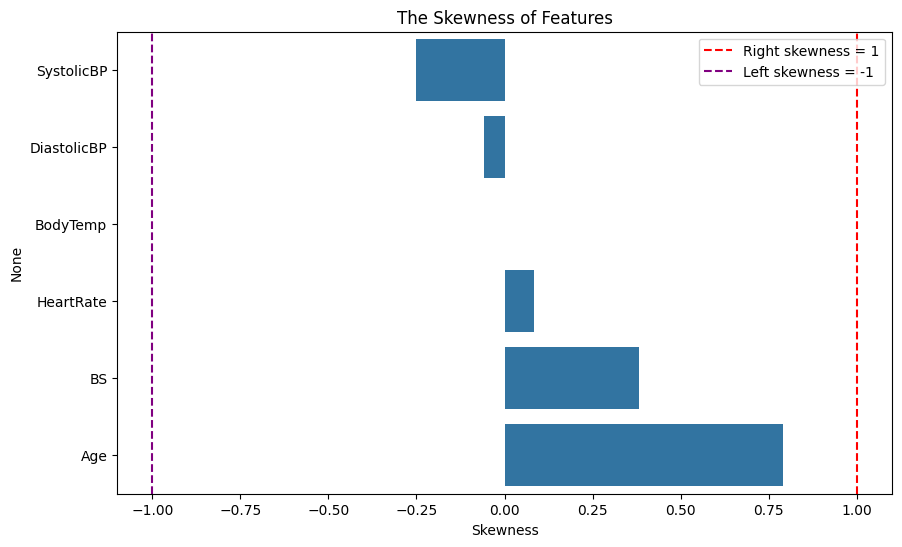

In [55]:
# ----- Check the data transfromer -----
# ----- Power Transformer (box-cox, yeo-johnson) is the best

# Calculate skewness of each feature
skewness2 = X_train_transformed.skew().sort_values()

# Create the bar plot
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=skewness2, y=skewness2.index)

# Set the title and labels
ax.set_title('The Skewness of Features')
ax.set_xlabel('Skewness')

# Add vertical lines at skewness thresholds of -1 and 1
plt.axvline(x=1, color='r', linestyle='--', label='Right skewness = 1')
plt.axvline(x=-1, color='purple', linestyle='--', label='Left skewness = -1')

# Add legend for vertical lines
plt.legend();

## Modeling

In [57]:
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from lightgbm import early_stopping
from catboost import CatBoostClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import StackingClassifier, VotingClassifier
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn.model_selection import RepeatedStratifiedKFold, RandomizedSearchCV, GridSearchCV

### Base models

In [58]:
def train_and_validate_models(X_train, y_train, X_val, y_val):
    """
    Train and validate multiple models, returning a DataFrame with accuracy on both training and validation sets.

    Parameters:
    X_train (DataFrame): Training features
    y_train (Series): Training target
    X_val (DataFrame): Validation features
    y_val (Series): Validation target

    Returns:
    DataFrame: A DataFrame with model names and their training and validation accuracies.
    """
    # Initialize the models with their default parameters
    models = {
        'Logistic Regression': LogisticRegression(),
        'SGD Logistic Regression': SGDClassifier(loss="log_loss"),
        'Decision Tree': DecisionTreeClassifier(),
        'K-Nearest Neighbors': KNeighborsClassifier(),
        'Random Forest': RandomForestClassifier(),
        'Extra Trees': ExtraTreesClassifier(),
        'AdaBoost': AdaBoostClassifier(),
        'XGBoost': XGBClassifier(),
        'LightGBM': LGBMClassifier(),
        'CatBoost': CatBoostClassifier()
    }
    
    # List to store model performance data
    model_performance = []
    
    for name, model in models.items():
        print(f"\nTraining {name}...")
        
        # Train the model on the training data
        model.fit(X_train, y_train)
        
        # Predict on the training and validation data
        y_train_pred = model.predict(X_train)
        y_val_pred = model.predict(X_val)
        
        # Calculate training and validation accuracy
        train_accuracy = accuracy_score(y_train, y_train_pred)
        val_accuracy = accuracy_score(y_val, y_val_pred)
        
        # Store the performance data in the list
        model_performance.append({
            'Models': name,
            'Train Accuracy': train_accuracy,
            'Validation Accuracy': val_accuracy
        })
        
        # # Print training and validation accuracy
        # print(f"Train Accuracy for {name}: {train_accuracy:.2f}")
        # print(f"Validation Accuracy for {name}: {val_accuracy:.2f}\n")
    
    # Convert the list of model performance data to a DataFrame
    performance_df = pd.DataFrame(model_performance)
    
    return performance_df


In [59]:
# Train all the models
models_performance_df = train_and_validate_models(X_train_scaled, y_train_encoded, X_valid_scaled, y_valid_encoded)



Training Logistic Regression...

Training SGD Logistic Regression...

Training Decision Tree...

Training K-Nearest Neighbors...

Training Random Forest...

Training Extra Trees...

Training AdaBoost...

Training XGBoost...

Training LightGBM...
[LightGBM] [Info] Number of positive: 457, number of negative: 457
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000057 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 162
[LightGBM] [Info] Number of data points in the train set: 914, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

In [60]:
models_performance_df

,Models,Train Accuracy,Validation Accuracy
0,Logistic Regression,0.745077,0.643678
1,SGD Logistic Regression,0.763676,0.724138
2,Decision Tree,0.949672,0.885057
3,K-Nearest Neighbors,0.865427,0.724138
4,Random Forest,0.949672,0.908046
5,Extra Trees,0.949672,0.885057
6,AdaBoost,0.843545,0.758621
7,XGBoost,0.948578,0.885057
8,LightGBM,0.946389,0.908046
9,CatBoost,0.931072,0.850575


## Hyperparameter Tuning

In [61]:
def plot_confusion_matrix(cm, dataset_type):
    """
    Plot confusion matrix with labels for a given model using ConfusionMatrixDisplay.
    """
    # Create the confusion matrix display object
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
        
    # Plot the confusion matrix
    disp.plot(cmap='Blues', values_format='d')
    plt.title(f"Confusion Matrix for {dataset_type} Set")
    plt.show()
    

def plot_roc_curve(fpr, tpr, roc_auc, model_name):
    """
    Plots the ROC curve for a given model.
    
    Parameters:
    - fpr (array): False Positive Rate values.
    - tpr (array): True Positive Rate values.
    - roc_auc (float): Area Under the Curve score.
    - model_name (str): Name of the model to be displayed in the plot legend.
    """
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=3, label=f'{model_name} ROC curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'r--')  # Diagonal line for random classifier
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate (FPR)')
    plt.ylabel('True Positive Rate (TPR)')
    plt.title(f'Receiver Operating Characteristic (ROC) Curve - {model_name}')
    plt.legend()
    plt.grid(True)
    plt.show()
  
  
def plot_multiple_roc_curves(models_roc_data):
    """
    Plots multiple ROC curves on a single plot.

    Parameters:
    - models_roc_data (dict): A dictionary where keys are model names (str) 
                              and values are tuples containing (fpr, tpr, auc).
                              
    Example format:
    models_roc_data = {
        'model names 1': (fpr_1, tpr_1, roc_auc_1),
        'model names 2': (fpr_2, tpr_2, roc_auc_2)
    }
    """
    fig, ax = plt.subplots(figsize=(8, 6))

    # Iterate over the dictionary and plot each model's ROC curve
    for model_name, (fpr, tpr, auc) in models_roc_data.items():
        ax.plot(fpr, tpr, lw=3, label=f'{model_name} (AUC = {auc:0.2f})')
    
    # Plot diagonal line for random classifier
    plt.plot([0, 1], [0, 1], 'r--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    ax.set_xlabel("False Positive Rate")
    ax.set_ylabel("True Positive Rate")
    ax.set_title("ROC - AUC Curve")
    ax.grid(True)
    ax.legend()
    fig.tight_layout()
    plt.show()
    

##### Logistic Regression


Best hyperparameters for Logistic Regression: {'C': 0.8, 'class_weight': 'balanced', 'max_iter': 100, 'random_state': 5, 'solver': 'sag'}

Training accuracy: 0.74

Classification report for Logistic Regression on the validation set:
               precision    recall  f1-score   support

elevated risk       0.74      0.65      0.69        52
     low risk       0.56      0.66      0.61        35

     accuracy                           0.66        87
    macro avg       0.65      0.66      0.65        87
 weighted avg       0.67      0.66      0.66        87



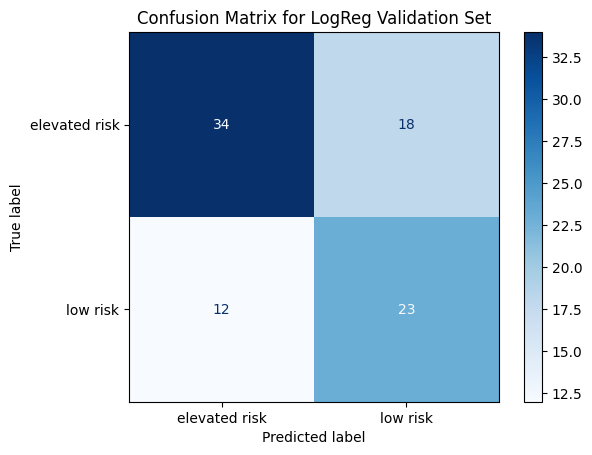

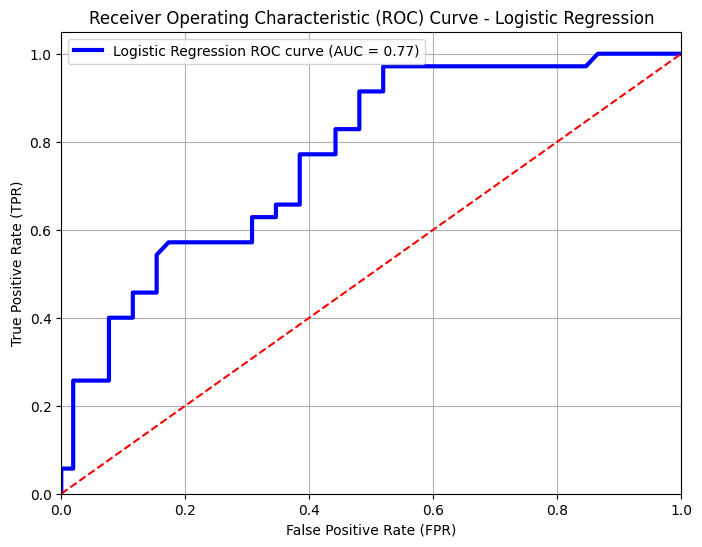

In [62]:
# Define the Logistic Regression model
logr = LogisticRegression()

# Define the full parameter grid for GridSearchCV 
lr_params = {
    "C": [0.01, 0.05, 0.07, 0.1, 0.8, 1., 2.],
    "class_weight": ["balanced", None],  
    "solver": ["liblinear", "sag", "saga", "lbfgs", "newton-cg", "newton-cholesky"],  
    "max_iter": [100, 500, 1000, 1500, 2000],
    "random_state": [SEED]
}

# Set up cross-validation strategy
n_splits = 10  # Number of splits
n_repeats = 5  # Number of repeat
cv = RepeatedStratifiedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=SEED)

# Set up GridSearchCV
logr_cv_model = GridSearchCV(estimator=logr, 
                            param_grid=lr_params, 
                             n_jobs=-1,      
                             cv=cv,
                             return_train_score=True)      

# Fit the model using GridSearchCV
logr_cv_model.fit(X_train_scaled, y_train_encoded)

# Print the best hyperparameters
print(f"\nBest hyperparameters for Logistic Regression: {logr_cv_model.best_params_}\n")

# Get the best model with best parameters
best_logr_model = logr_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_logr_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set
y_pred_logr_encoded = best_logr_model.predict(X_valid_scaled)

# # Inverse transform predictions to original class labels
y_pred_logr = label_encoder.inverse_transform(y_pred_logr_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for Logistic Regression on the validation set:")
print(classification_report(y_valid_original, y_pred_logr, zero_division=0))

# Plot Confusion Matrix
cm_valid_logr = confusion_matrix(y_valid_original, y_pred_logr)
plot_confusion_matrix(cm_valid_logr, "LogReg Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_logr = best_logr_model.predict_proba(X_valid_scaled)[:, 1]  
# Compute ROC curve
fpr_logr, tpr_logr, _ = roc_curve(y_valid_encoded, y_prob_logr)

# Compute AUC using roc_auc_score
roc_auc_logr = roc_auc_score(y_valid_encoded, y_prob_logr)

# Plot ROC curve
plot_roc_curve(fpr_logr, tpr_logr, roc_auc_logr, 'Logistic Regression')

##### SGD Classifier for Logistic Regression

Fitting 100 folds for each of 30 candidates, totalling 3000 fits


/home/enge/.local/lib/python3.12/site-packages/sklearn/linear_model/_stochastic_gradient.py:744: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/home/enge/.local/lib/python3.12/site-packages/sklearn/linear_model/_stochastic_gradient.py:744: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/home/enge/.local/lib/python3.12/site-packages/sklearn/linear_model/_stochastic_gradient.py:744: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/home/enge/.local/lib/python3.12/site-packages/sklearn/linear_model/_stochastic_gradient.py:744: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/home/enge/.local/lib/python3.12/site-packag


Best hyperparameters for SGD Logistic Regression: {'tol': 1e-06, 'max_iter': 1000, 'loss': 'log_loss', 'learning_rate': 'constant', 'eta0': 0.01, 'class_weight': None, 'alpha': 1e-05}

Training accuracy: 0.75

Classification report for SGD Logistic Regression on the validation set:
               precision    recall  f1-score   support

elevated risk       0.77      0.63      0.69        52
     low risk       0.57      0.71      0.63        35

     accuracy                           0.67        87
    macro avg       0.67      0.67      0.66        87
 weighted avg       0.69      0.67      0.67        87



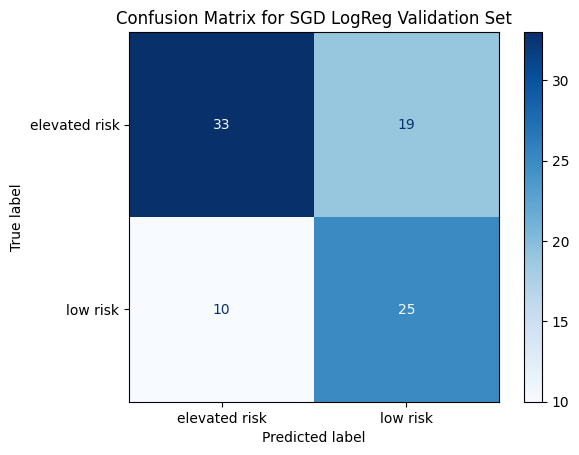

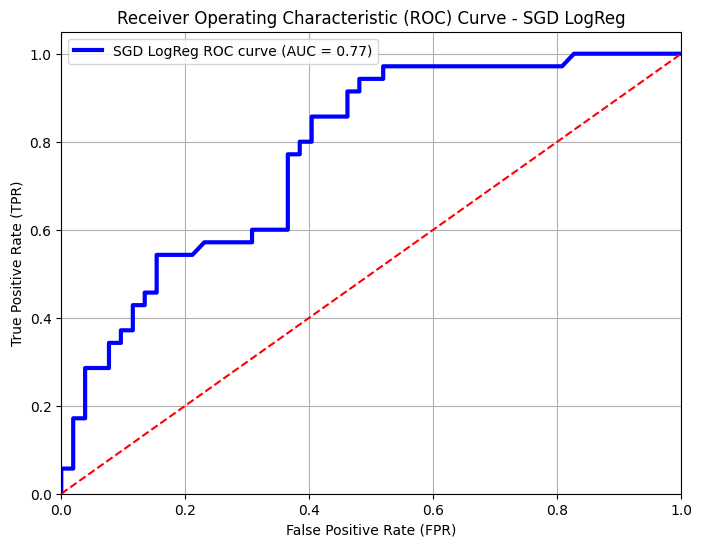

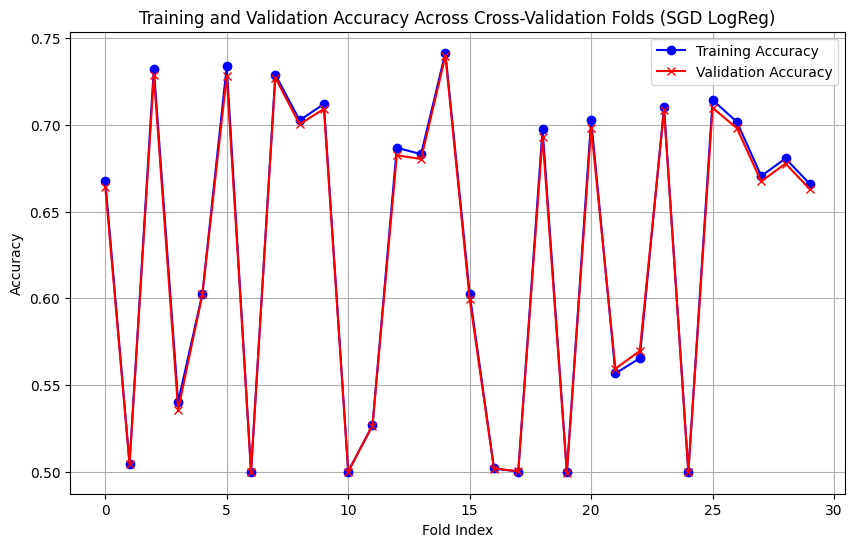

In [63]:
# Define the SGDClassifier for Logistic Regression
sgd_logreg = SGDClassifier()

# Define the full parameter grid for RandomizedSearchCV
sgd_params = {
    "loss": ["log_loss"], # log_loss for logistic regression
    "alpha": [0.00001, 0.0001, 0.001, 0.01, 0.1, 1.0],  
    "max_iter": [1000, 2000, 3000, 5000, 10000], 
    "tol": [1e-2, 1e-3, 1e-4, 1e-5, 1e-6],
    "learning_rate": ["constant", "optimal", "invscaling", "adaptive"], 
    "eta0": [0.0001, 0.001, 0.01], 
    "class_weight": [None, 'balanced']
}

# Set up cross-validation strategy
n_splits = 20
n_repeats = 5
cv = RepeatedStratifiedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=SEED)

# Set up RandomizedSearchCV to search over the hyperparameters
sgd_cv_model = RandomizedSearchCV(estimator=sgd_logreg,
                                   param_distributions=sgd_params,
                                   n_iter=30,  
                                   n_jobs=-1,   
                                   cv=cv,       
                                   verbose=1,   
                                   random_state=SEED,
                                   return_train_score=True)

# Fit the model using RandomizedSearchCV
sgd_cv_model.fit(X_train_scaled, y_train_encoded)

# Print best hyperparameters
print(f"\nBest hyperparameters for SGD Logistic Regression: {sgd_cv_model.best_params_}\n")

# Get the best model with best parameters
best_sgd_model = sgd_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_sgd_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate the model on the validation set
y_pred_sgd_encoded = best_sgd_model.predict(X_valid_scaled)

# Inverse transform predictions to original class labels
y_pred_sgd = label_encoder.inverse_transform(y_pred_sgd_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for SGD Logistic Regression on the validation set:")
print(classification_report(y_valid_original, y_pred_sgd, zero_division=0))

# Plot Confusion Matrix
cm_valid_sgd = confusion_matrix(y_valid_original, y_pred_sgd)
plot_confusion_matrix(cm_valid_sgd, "SGD LogReg Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_sgd = best_sgd_model.predict_proba(X_valid_scaled)[:, 1]  
# Compute ROC curve
fpr_sgd, tpr_sgd, _ = roc_curve(y_valid_encoded, y_prob_sgd)

# Compute AUC using roc_auc_score
roc_auc_sgd = roc_auc_score(y_valid_encoded, y_prob_sgd)

# Plot ROC curve
plot_roc_curve(fpr_sgd, tpr_sgd, roc_auc_sgd, 'SGD LogReg')


# --------------- Cross-validation performance tracking ---------------

# Get the cross-validation results from GridSearchCV
cv_results_sgd = sgd_cv_model.cv_results_

# Number of splits and repeats used in the cross-validation
total_folds = n_splits * n_repeats  # Total number of folds 

# Extract the per-fold test scores (validation scores)
mean_test_scores = cv_results_sgd['mean_test_score']  # Mean validation scores across all folds

# Extract the per-fold training scores (training accuracies)
mean_train_scores = cv_results_sgd['mean_train_score']  # Mean training scores across all folds

# Plot the training and validation accuracies for each fold
plt.figure(figsize=(10, 6))

# Plot training and validation accuracies
plt.plot(mean_train_scores, label="Training Accuracy", color='blue', marker='o')
plt.plot(mean_test_scores, label="Validation Accuracy", color='red', marker='x')
plt.title('Training and Validation Accuracy Across Cross-Validation Folds (SGD LogReg)')
plt.xlabel('Fold Index')
plt.ylabel('Accuracy')
plt.legend(loc='best')
plt.grid(True)
plt.show()

##### Decision Tree Classifier 

Fitting 100 folds for each of 192 candidates, totalling 19200 fits

Best hyperparameters for Decision Tree: {'criterion': 'gini', 'max_depth': 30, 'min_samples_leaf': 1, 'min_samples_split': 2, 'random_state': 5}

Training accuracy: 0.95

Classification report for Decision Tree on the validation set:
               precision    recall  f1-score   support

elevated risk       0.89      0.92      0.91        52
     low risk       0.88      0.83      0.85        35

     accuracy                           0.89        87
    macro avg       0.88      0.88      0.88        87
 weighted avg       0.88      0.89      0.88        87



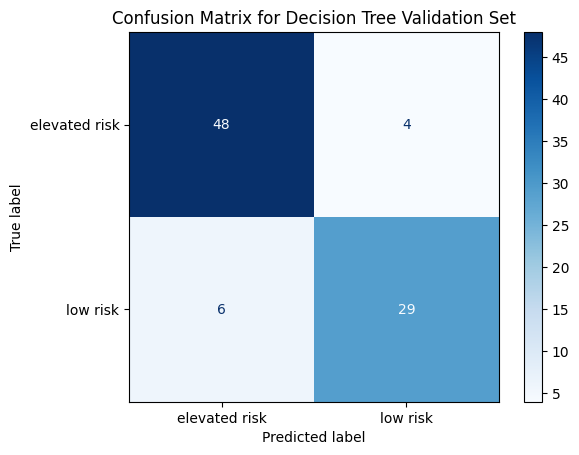

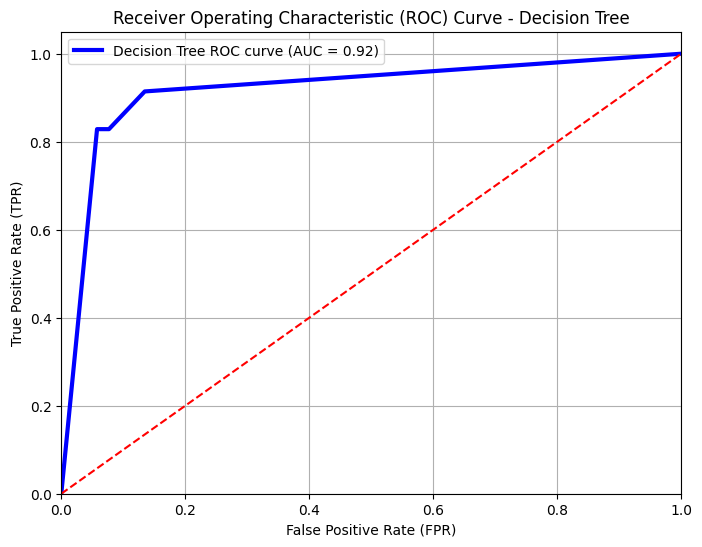

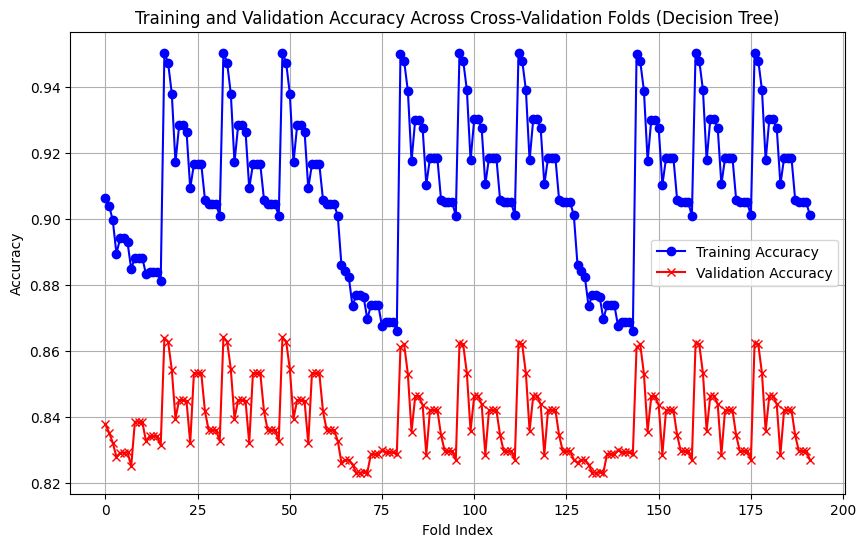

In [64]:
# Define the Decision Tree model
dt = DecisionTreeClassifier()

# Define the full parameter grid for GridSearchCV
dt_params = {
    "criterion": ["gini", "entropy", "log_loss"], 
    "max_depth": [10, 20, 30, None],  
    "min_samples_split": [2, 3, 5, 10],  
    "min_samples_leaf": [1, 2, 3, 4],  
    "random_state": [SEED]
}

# Set up cross-validation strategy
n_splits = 20  
n_repeats = 5  
cv = RepeatedStratifiedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=SEED)

# Set up GridSearchCV
dt_cv_model = GridSearchCV(estimator=dt,
                           param_grid=dt_params,
                           n_jobs=-1,      
                           cv=cv,           
                           verbose=1,
                           return_train_score=True)      

# Fit the model using GridSearchCV
dt_cv_model.fit(X_train_scaled, y_train_encoded)

# Print the best hyperparameters
print(f"\nBest hyperparameters for Decision Tree: {dt_cv_model.best_params_}\n")

# Get the best model with best parameters
best_dt_model = dt_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_dt_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set using best model
y_pred_dt_encoded = best_dt_model.predict(X_valid_scaled)

# # Inverse transform predictions to original class labels
y_pred_dt = label_encoder.inverse_transform(y_pred_dt_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for Decision Tree on the validation set:")
print(classification_report(y_valid_original, y_pred_dt, zero_division=0))

# Plot Confusion Matrix
cm_valid_dt = confusion_matrix(y_valid_original, y_pred_dt)
plot_confusion_matrix(cm_valid_dt, "Decision Tree Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_dt = best_dt_model.predict_proba(X_valid_scaled)[:, 1]  
# Compute ROC curve
fpr_dt, tpr_dt, _ = roc_curve(y_valid_encoded, y_prob_dt)

# Compute AUC using roc_auc_score
roc_auc_dt = roc_auc_score(y_valid_encoded, y_prob_dt)

# Plot ROC curve
plot_roc_curve(fpr_dt, tpr_dt, roc_auc_dt, 'Decision Tree')


# --------------- Cross-validation performance tracking ---------------

# Get the cross-validation results from GridSearchCV
cv_results_dt = dt_cv_model.cv_results_

# Number of splits and repeats used in the cross-validation
total_folds = n_splits * n_repeats  # Total number of folds 

# Extract the per-fold test scores (validation scores)
mean_test_scores = cv_results_dt['mean_test_score']  # Mean validation scores across all folds

# Extract the per-fold training scores (training accuracies)
mean_train_scores = cv_results_dt['mean_train_score']  # Mean training scores across all folds

# Plot the training and validation accuracies for each fold
plt.figure(figsize=(10, 6))

# Plot training and validation accuracies
plt.plot(mean_train_scores, label="Training Accuracy", color='blue', marker='o')
plt.plot(mean_test_scores, label="Validation Accuracy", color='red', marker='x')
plt.title('Training and Validation Accuracy Across Cross-Validation Folds (Decision Tree)')
plt.xlabel('Fold Index')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

##### K-Nearest Neighbors Classifier 


Best hyperparameters for K-Nearest Neighbors: {'weights': 'distance', 'p': 1, 'n_neighbors': 31, 'metric': 'euclidean', 'leaf_size': 20, 'algorithm': 'ball_tree'}

Training accuracy: 0.95

Classification report for K-Nearest Neighbors on the validation set:
               precision    recall  f1-score   support

elevated risk       0.91      0.94      0.92        52
     low risk       0.91      0.86      0.88        35

     accuracy                           0.91        87
    macro avg       0.91      0.90      0.90        87
 weighted avg       0.91      0.91      0.91        87



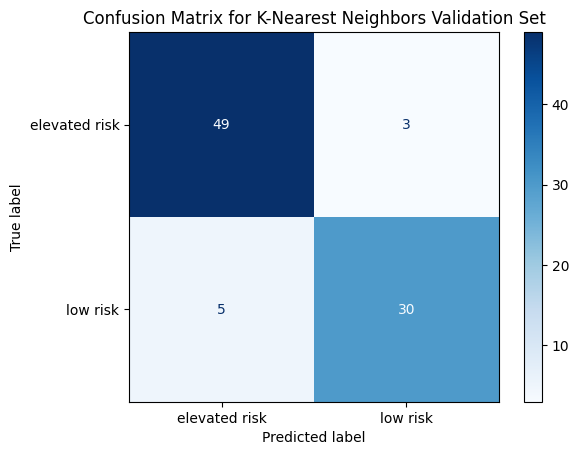

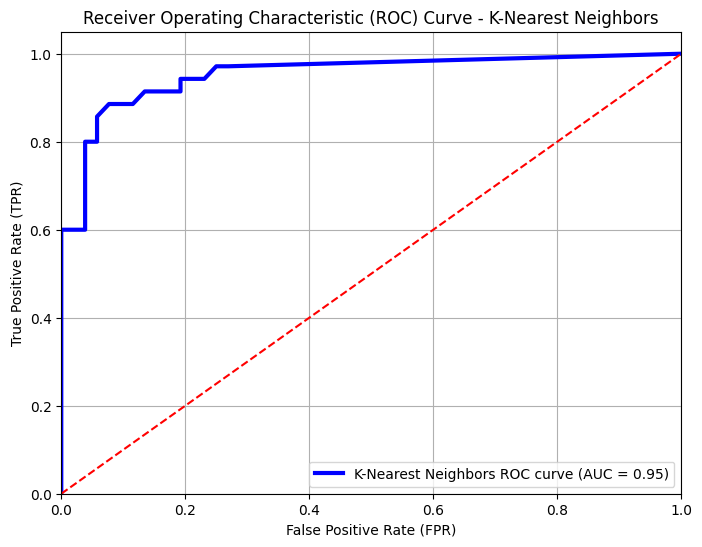

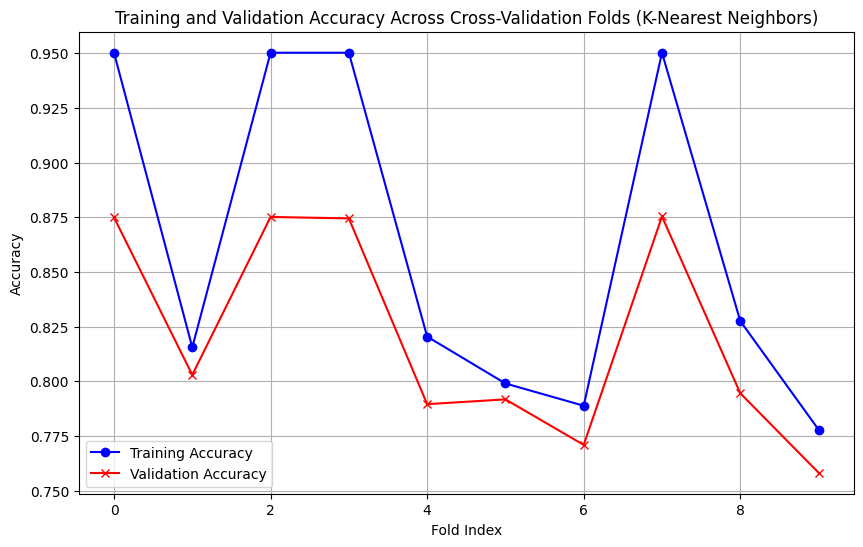

In [65]:
# Define the KNN model  
knn = KNeighborsClassifier()

# Define the full parameter grid for RandomizedSearchCV
knn_params = {
    "n_neighbors": [i for i in range(1, 51)],  
    "weights": ["uniform", "distance"],  
    "algorithm": ["auto", "ball_tree", "kd_tree", "brute"],  
    "leaf_size": [20, 30, 40, 50, 60],  
    "p": [1, 2],  # Power parameter for the Minkowski distance (1 for Manhattan, 2 for Euclidean)
    "metric": ["euclidean", "manhattan"],  
}

# Set up cross-validation strategy
n_splits = 30  
n_repeats = 5  
cv = RepeatedStratifiedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=SEED)

# Set up RandomizedSearchCV with a number of iterations to sample
knn_cv_model = RandomizedSearchCV(estimator=knn,
                                  param_distributions=knn_params,
                                  n_iter=10,  
                                  n_jobs=-1,  
                                  cv=cv,  
                                  random_state=SEED,
                                  return_train_score=True)

# Fit the model using RandomizedSearchCV
knn_cv_model.fit(X_train_scaled, y_train_encoded)

# Print the best hyperparameters
print(f"\nBest hyperparameters for K-Nearest Neighbors: {knn_cv_model.best_params_}\n")

# Get the best model with best parameters
best_knn_model = knn_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_knn_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set
y_pred_knn_encoded = best_knn_model.predict(X_valid_scaled)

# Inverse transform predictions to original class labels
y_pred_knn = label_encoder.inverse_transform(y_pred_knn_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for K-Nearest Neighbors on the validation set:")
print(classification_report(y_valid_original, y_pred_knn, zero_division=0))

# Plot Confusion Matrix
cm_valid_knn = confusion_matrix(y_valid_original, y_pred_knn)
plot_confusion_matrix(cm_valid_knn, "K-Nearest Neighbors Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_knn = best_knn_model.predict_proba(X_valid_scaled)[:, 1]  # Probability for the positive class

# Compute ROC curve
fpr_knn, tpr_knn, _ = roc_curve(y_valid_encoded, y_prob_knn)

# Compute AUC using roc_auc_score
roc_auc_knn = roc_auc_score(y_valid_encoded, y_prob_knn)

# Plot ROC curve
plot_roc_curve(fpr_knn, tpr_knn, roc_auc_knn, 'K-Nearest Neighbors')


# --------------- Cross-validation performance tracking ---------------

# Get the cross-validation results from RandomizedSearchCV
cv_results_knn = knn_cv_model.cv_results_

# Number of splits and repeats used in the cross-validation
total_folds = n_splits * n_repeats  # Total number of folds

# Extract the per-fold test scores (validation scores)
mean_test_scores = cv_results_knn['mean_test_score']  # Mean validation scores across all folds

# Extract the per-fold training scores (training accuracies)
mean_train_scores = cv_results_knn['mean_train_score']  # Mean training scores across all folds

# Plot the training and validation accuracies for each fold
plt.figure(figsize=(10, 6))

# Plot training and validation accuracies
plt.plot(mean_train_scores, label="Training Accuracy", color='blue', marker='o')
plt.plot(mean_test_scores, label="Validation Accuracy", color='red', marker='x')
plt.title('Training and Validation Accuracy Across Cross-Validation Folds (K-Nearest Neighbors)')
plt.xlabel('Fold Index')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()


#### Ensemble Learning Method:

##### Random Forest Classifier 


Best hyperparameters for Random Forest: {'n_estimators': 100, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': None, 'max_depth': 50, 'criterion': 'entropy', 'class_weight': 'balanced'}

Training accuracy: 0.93

Classification report for Random Forest on the validation set:
               precision    recall  f1-score   support

elevated risk       0.86      0.81      0.83        52
     low risk       0.74      0.80      0.77        35

     accuracy                           0.80        87
    macro avg       0.80      0.80      0.80        87
 weighted avg       0.81      0.80      0.81        87



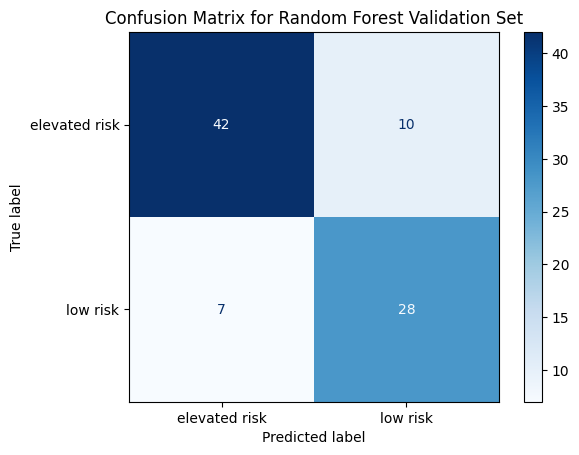

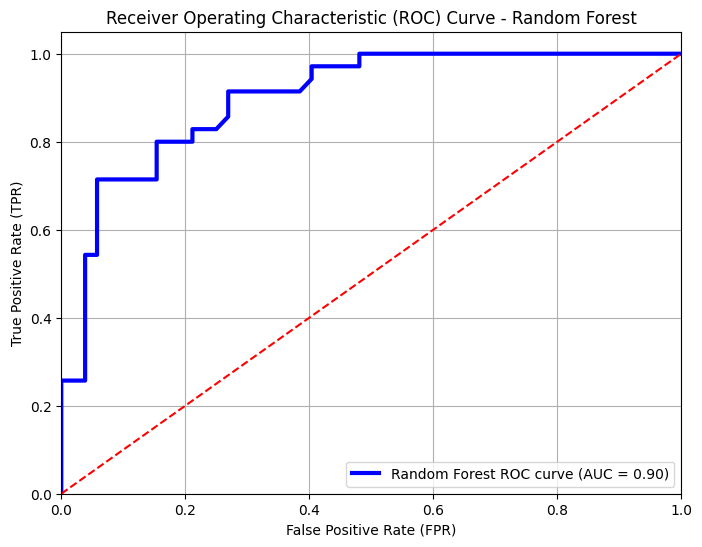

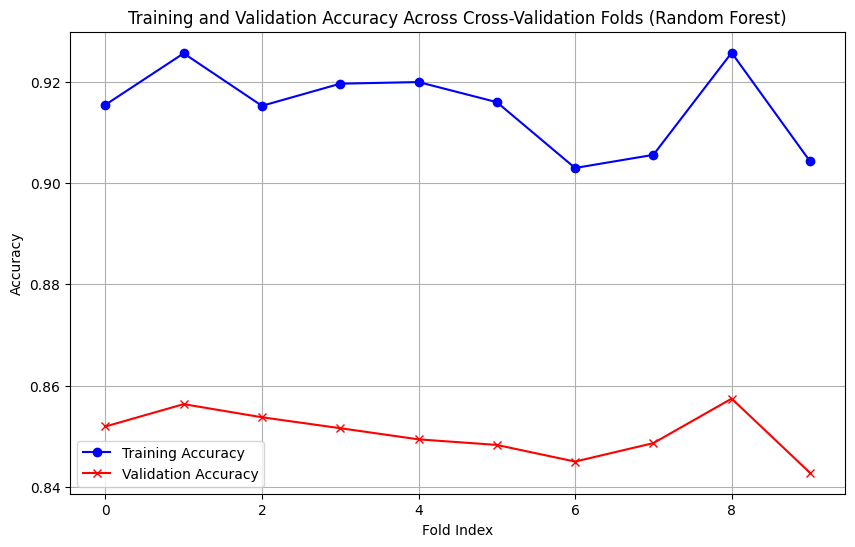

In [66]:
# Define the Random Forest model
rf = RandomForestClassifier()

# Define the full parameter grid for RandomizedSearchCV
rf_params = {
    "n_estimators": [100, 200, 300, 500],
    "criterion": ["gini", "entropy", "log_loss"], 
    "max_depth": [20, 40, 50, None],
    "min_samples_split": [2, 5, 10],
    "min_samples_leaf": [1, 2, 4], 
    "class_weight": ["balanced", "balanced_subsample", None],
    "max_features": ["sqrt", "log2", None]
}

# Set up cross-validation strategy
n_splits = 10  
n_repeats = 3  
cv = RepeatedStratifiedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=SEED)

# Set up RandomizedSearchCV with a number of iterations to sample
rf_cv_model = RandomizedSearchCV(estimator=rf,
                                 param_distributions=rf_params,
                                 n_iter=10,  
                                 n_jobs=-1,   
                                 cv=cv,       
                                 random_state=SEED,
                                 return_train_score=True)

# Fit the model using RandomizedSearchCV
rf_cv_model.fit(X_train_scaled, y_train_encoded)

# Print the best hyperparameters
print(f"\nBest hyperparameters for Random Forest: {rf_cv_model.best_params_}\n")

# Get the best model with best parameters
best_rf_model = rf_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_rf_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set
y_pred_rf_encoded = best_rf_model.predict(X_valid_scaled)

# # Inverse transform predictions to original class labels
y_pred_rf = label_encoder.inverse_transform(y_pred_rf_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for Random Forest on the validation set:")
print(classification_report(y_valid_original, y_pred_rf, zero_division=0))

# Plot Confusion Matrix
cm_valid_rf = confusion_matrix(y_valid_original, y_pred_rf)
plot_confusion_matrix(cm_valid_rf, "Random Forest Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_rf = best_rf_model.predict_proba(X_valid_scaled)[:, 1]  
# Compute ROC curve
fpr_rf, tpr_rf, _ = roc_curve(y_valid_encoded, y_prob_rf)

# Compute AUC using roc_auc_score
roc_auc_rf = roc_auc_score(y_valid_encoded, y_prob_rf)

# Plot ROC curve
plot_roc_curve(fpr_rf, tpr_rf, roc_auc_rf, 'Random Forest')


# --------------- Cross-validation performance tracking ---------------

# Get the cross-validation results from GridSearchCV
cv_results_rf = rf_cv_model.cv_results_

# Number of splits and repeats used in the cross-validation
total_folds = n_splits * n_repeats  # Total number of folds 

# Extract the per-fold test scores (validation scores)
mean_test_scores = cv_results_rf['mean_test_score']  # Mean validation scores across all folds

# Extract the per-fold training scores (training accuracies)
mean_train_scores = cv_results_rf['mean_train_score']  # Mean training scores across all folds

# Plot the training and validation accuracies for each fold
plt.figure(figsize=(10, 6))

# Plot training and validation accuracies
plt.plot(mean_train_scores, label="Training Accuracy", color='blue', marker='o')
plt.plot(mean_test_scores, label="Validation Accuracy", color='red', marker='x')
plt.title('Training and Validation Accuracy Across Cross-Validation Folds (Random Forest)')
plt.xlabel('Fold Index')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

##### Extra Trees Classifier


Best hyperparameters for ExtraTreesClassifier: {'random_state': 5, 'n_estimators': 200, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': None, 'max_depth': 30, 'criterion': 'entropy', 'class_weight': None, 'bootstrap': False}

Training accuracy: 0.95

Classification report for Extra Trees on the validation set:
               precision    recall  f1-score   support

elevated risk       0.91      0.92      0.91        52
     low risk       0.88      0.86      0.87        35

     accuracy                           0.90        87
    macro avg       0.89      0.89      0.89        87
 weighted avg       0.90      0.90      0.90        87



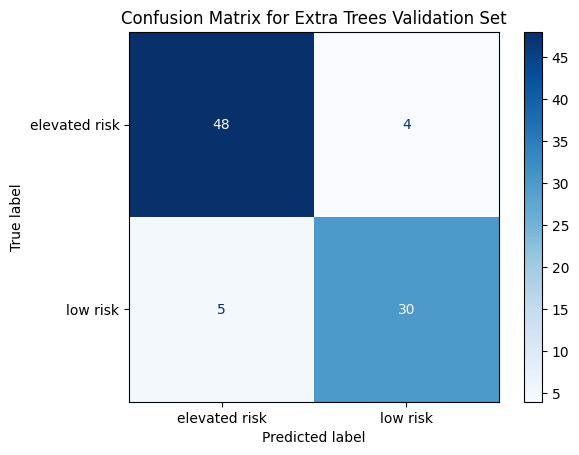

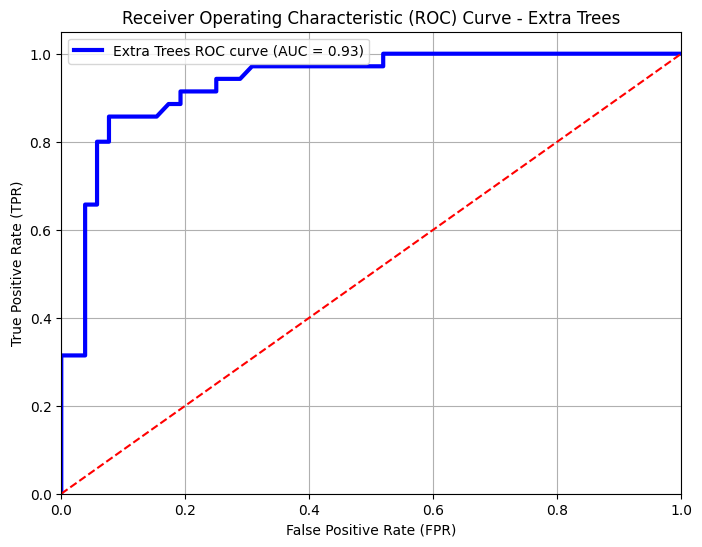

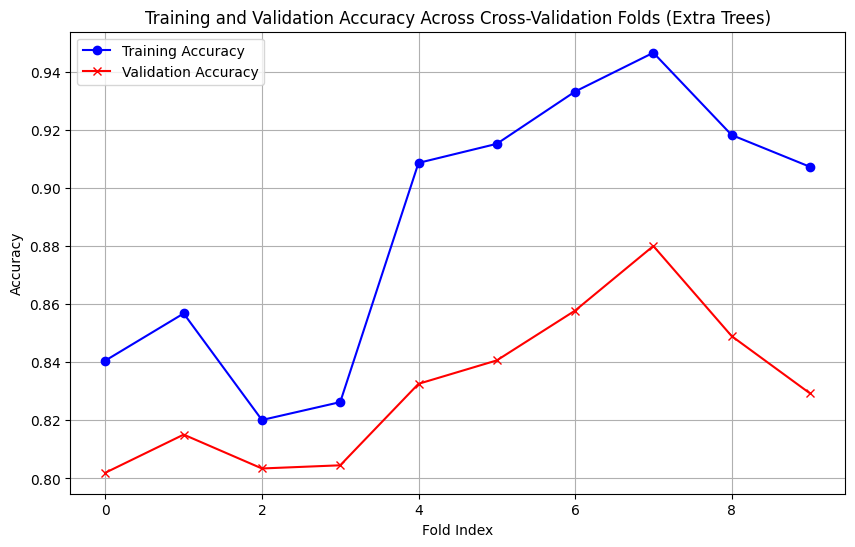

In [67]:
# Define the Extra Trees Classifier model
et = ExtraTreesClassifier()

# Define the full parameter grid for RandomizedSearchCV
et_params = {
    "n_estimators": [100, 200, 300, 500],
    "criterion": ["gini", "entropy", "log_loss"],  
    "max_depth": [None, 10, 20, 30, 40],
    "min_samples_split": [2, 5, 7, 10],  
    "min_samples_leaf": [1, 2, 3, 4],  
    "max_features": ["sqrt", "log2", None],  
    "bootstrap": [True, False],  
    "class_weight": ["balanced", None], 
    "random_state": [SEED]
}

# Set up cross-validation strategy
n_splits = 10  
n_repeats = 3  
cv = RepeatedStratifiedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=SEED)

# Set up RandomizedSearchCV with a number of iterations to sample
et_cv_model = RandomizedSearchCV(estimator=et,
                                 param_distributions=et_params,
                                 n_iter=10,  
                                 n_jobs=-1,  
                                 cv=cv,  
                                 random_state=SEED,
                                 return_train_score=True)

# Fit the model using RandomizedSearchCV
et_cv_model.fit(X_train_scaled, y_train_encoded)

# Print the best hyperparameters
print(f"\nBest hyperparameters for ExtraTreesClassifier: {et_cv_model.best_params_}\n")

# Get the best model with best parameters
best_et_model = et_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_et_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set
y_pred_et_encoded = best_et_model.predict(X_valid_scaled)

# Inverse transform predictions to original class labels
y_pred_et = label_encoder.inverse_transform(y_pred_et_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for Extra Trees on the validation set:")
print(classification_report(y_valid_original, y_pred_et, zero_division=0))

# Plot Confusion Matrix
cm_valid_et = confusion_matrix(y_valid_original, y_pred_et)
plot_confusion_matrix(cm_valid_et, "Extra Trees Validation")

# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_et = best_et_model.predict_proba(X_valid_scaled)[:, 1]  

# Compute ROC curve
fpr_et, tpr_et, _ = roc_curve(y_valid_encoded, y_prob_et)

# Compute AUC using roc_auc_score
roc_auc_et = roc_auc_score(y_valid_encoded, y_prob_et)

# Plot ROC curve
plot_roc_curve(fpr_et, tpr_et, roc_auc_et, 'Extra Trees')


# --------------- Cross-validation performance tracking ---------------

# Get the cross-validation results from RandomizedSearchCV
cv_results_et = et_cv_model.cv_results_

# Number of splits and repeats used in the cross-validation
total_folds = n_splits * n_repeats  # Total number of folds

# Extract the per-fold test scores (validation scores)
mean_test_scores = cv_results_et['mean_test_score']  

# Extract the per-fold training scores (training accuracies)
mean_train_scores = cv_results_et['mean_train_score']  

# Plot the training and validation accuracies for each fold
plt.figure(figsize=(10, 6))

# Plot training and validation accuracies
plt.plot(mean_train_scores, label="Training Accuracy", color='blue', marker='o')
plt.plot(mean_test_scores, label="Validation Accuracy", color='red', marker='x')
plt.title('Training and Validation Accuracy Across Cross-Validation Folds (Extra Trees)')
plt.xlabel('Fold Index')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()


##### AdaBoost Classifier


Best hyperparameters for AdaBoost: {'random_state': 5, 'n_estimators': 100, 'learning_rate': 0.5, 'algorithm': 'SAMME'}

Training accuracy: 0.82

Classification report for AdaBoost on the validation set:
               precision    recall  f1-score   support

elevated risk       0.89      0.65      0.76        52
     low risk       0.63      0.89      0.74        35

     accuracy                           0.75        87
    macro avg       0.76      0.77      0.75        87
 weighted avg       0.79      0.75      0.75        87



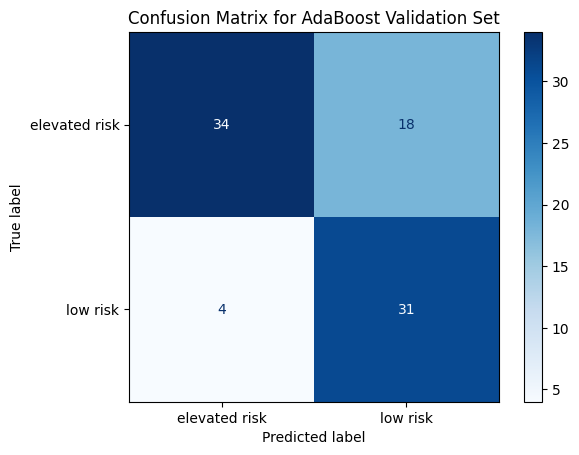

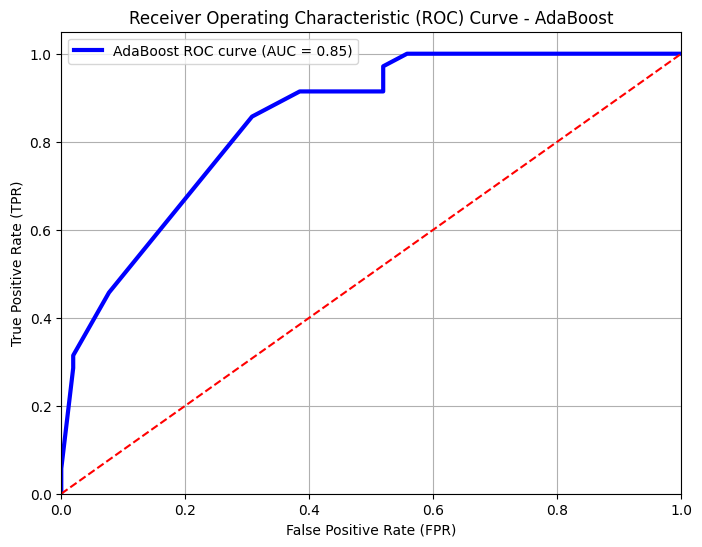

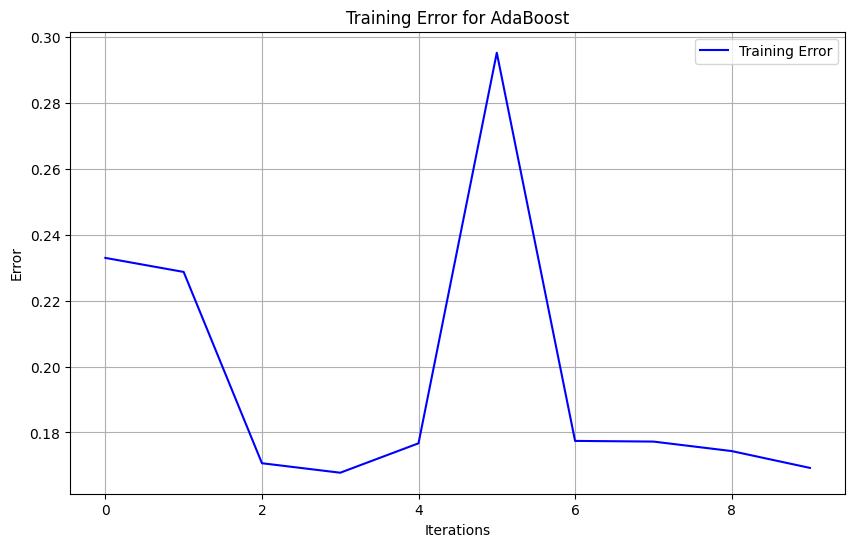

In [68]:
# Define the AdaBoost Classifier model
ada_boost = AdaBoostClassifier()

# Define the full parameter grid for RandomizedSearchCV 
ada_params = {
    "n_estimators": [100, 200, 300, 400, 500], 
    "learning_rate": [0.01, 0.1, 0.5, 1.0], 
    "algorithm": ["SAMME"],
    "random_state": [SEED]
}

# Set up cross-validation strategy
n_splits = 10  
n_repeats = 3  
cv = RepeatedStratifiedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=SEED)

# Set up RandomizedSearchCV with a number of iterations to sample
ada_cv_model = RandomizedSearchCV(estimator=ada_boost,
                                  param_distributions=ada_params,
                                  n_iter=10,  
                                  n_jobs=-1,  
                                  cv=cv,  
                                  random_state=SEED,
                                  return_train_score=True)

# Fit the model using RandomizedSearchCV
ada_cv_model.fit( X_train_scaled, y_train_encoded)


# Print the best hyperparameters
print(f"\nBest hyperparameters for AdaBoost: {ada_cv_model.best_params_}\n")

# Get the best model with best parameters
best_ada_model = ada_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_ada_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set
y_pred_ada_encoded = best_ada_model.predict(X_valid_scaled)

# Inverse transform predictions to original class labels
y_pred_ada = label_encoder.inverse_transform(y_pred_ada_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for AdaBoost on the validation set:")
print(classification_report(y_valid_original, y_pred_ada, zero_division=0))

# Plot Confusion Matrix
cm_valid_ada = confusion_matrix(y_valid_original, y_pred_ada)
plot_confusion_matrix(cm_valid_ada, "AdaBoost Validation")

# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_ada = best_ada_model.predict_proba(X_valid_scaled)[:, 1]  # Probability for the positive class

# Compute ROC curve
fpr_ada, tpr_ada, _ = roc_curve(y_valid_encoded, y_prob_ada)

# Compute AUC using roc_auc_score
roc_auc_ada = roc_auc_score(y_valid_encoded, y_prob_ada)

# Plot ROC curve
plot_roc_curve(fpr_ada, tpr_ada, roc_auc_ada, 'AdaBoost')

# -------------------- Plot Loss --------------------

# AdaBoost doesn't provide a direct method like CatBoost to get training and validation losses.
# Instead, we can track training errors by using the model's performance over iterations.
# We will plot the training error as it typically decreases over time.

# Getting the training error for each iteration
train_errors = [1 - score for score in ada_cv_model.cv_results_['mean_train_score']]

# Plot training error over the course of the iterations
plt.figure(figsize=(10, 6))
plt.plot(train_errors, label='Training Error', color='blue')
plt.title('Training Error for AdaBoost')
plt.xlabel('Iterations')
plt.ylabel('Error')
plt.legend()
plt.grid(True)
plt.show()


##### XGBoost Classifier 

In [69]:
# Define the XGBoost model
xgb_model = XGBClassifier()

# Define the full parameter grid for RandomizedSearchCV
xgb_params = {
    "learning_rate": [0.0001, 0.001, 0.005, 0.01, 0.05, 0.1],  
    "max_depth": [2, 4, 6, 10, 15, 20, 30], 
    "n_estimators": [100, 200, 400, 500, 700, 1000],  
    "subsample": [0.5, 0.8, 0.9, 1.0],  
    "colsample_bytree": [0.5, 0.8, 0.9, 1.0],  
    "random_state": [SEED]
}

# Set up cross-validation strategy
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=SEED)

# Set up RandomizedSearchCV with a number of iterations to sample
xgb_cv_model = RandomizedSearchCV(estimator=xgb_model,
                                  param_distributions=xgb_params,
                                  n_iter=20,  
                                  n_jobs=-1,   
                                  cv=cv,      
                                  random_state=SEED)  

# Fit the model using RandomizedSearchCV
xgb_cv_model.fit(
    X_train_scaled, y_train_encoded,
    eval_set=[(X_train_scaled, y_train_encoded), (X_valid_scaled, y_valid_encoded)], 
    verbose=True
)

[0]	validation_0-logloss:0.64376	validation_1-logloss:0.65430
[1]	validation_0-logloss:0.60610	validation_1-logloss:0.62984
[2]	validation_0-logloss:0.57615	validation_1-logloss:0.60665
[0]	validation_0-logloss:0.64462	validation_1-logloss:0.65427
[3]	validation_0-logloss:0.54886	validation_1-logloss:0.58861
[0]	validation_0-logloss:0.64284	validation_1-logloss:0.65202
[0]	validation_0-logloss:0.64239	validation_1-logloss:0.65019
[1]	validation_0-logloss:0.60746	validation_1-logloss:0.62771
[1]	validation_0-logloss:0.60617	validation_1-logloss:0.62635
[1]	validation_0-logloss:0.60572	validation_1-logloss:0.62717
[2]	validation_0-logloss:0.57655	validation_1-logloss:0.59834
[2]	validation_0-logloss:0.57527	validation_1-logloss:0.60013
[2]	validation_0-logloss:0.57429	validation_1-logloss:0.60326
[3]	validation_0-logloss:0.54937	validation_1-logloss:0.58439
[3]	validation_0-logloss:0.54849	validation_1-logloss:0.58202
[3]	validation_0-logloss:0.54656	validation_1-logloss:0.58777
[4]	vali

RandomizedSearchCV(cv=RepeatedStratifiedKFold(n_repeats=2, n_splits=5, random_state=5),
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=None, grow_policy=None,
                                           im...
                                           multi_strategy=None,
                                           n_estimators=None, n_jobs=None,
                                           num_parallel_tree=None,
                                           random_state=None, ...),
                   n_iter=20, n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.5, 0.8, 0.9,
                                                             1.0],
                                        'learning_rate': [0.0001, 0.001, 0.005,
                                                          0.01, 0.05, 0.1],
                                        'max_depth': [2, 4, 6, 10, 15, 20, 30],
                                        'n_estimators': [100, 200, 400, 500,
                                                         700, 1000],
                                        'random_state': [5],
                                        'subsample': [0.5, 0.8, 0.9, 1.0]},
                   random_state=5)


Best hyperparameters for XGBoost: {'subsample': 0.8, 'random_state': 5, 'n_estimators': 1000, 'max_depth': 4, 'learning_rate': 0.05, 'colsample_bytree': 0.8}

Training accuracy: 0.95

Classification report for XGBoost on the validation set:
               precision    recall  f1-score   support

elevated risk       0.92      0.88      0.90        52
     low risk       0.84      0.89      0.86        35

     accuracy                           0.89        87
    macro avg       0.88      0.89      0.88        87
 weighted avg       0.89      0.89      0.89        87



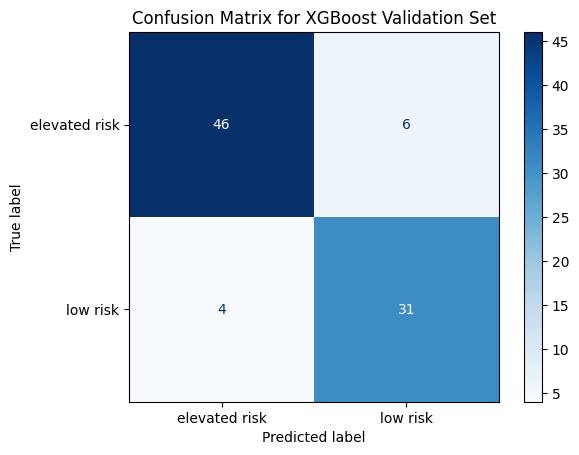

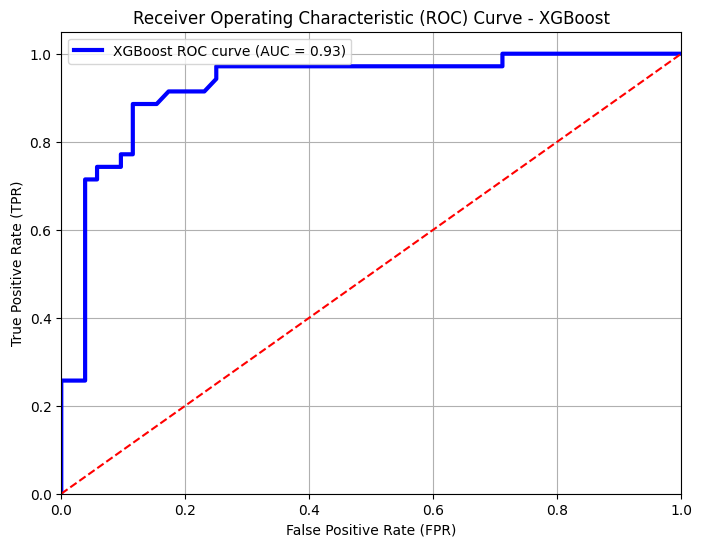

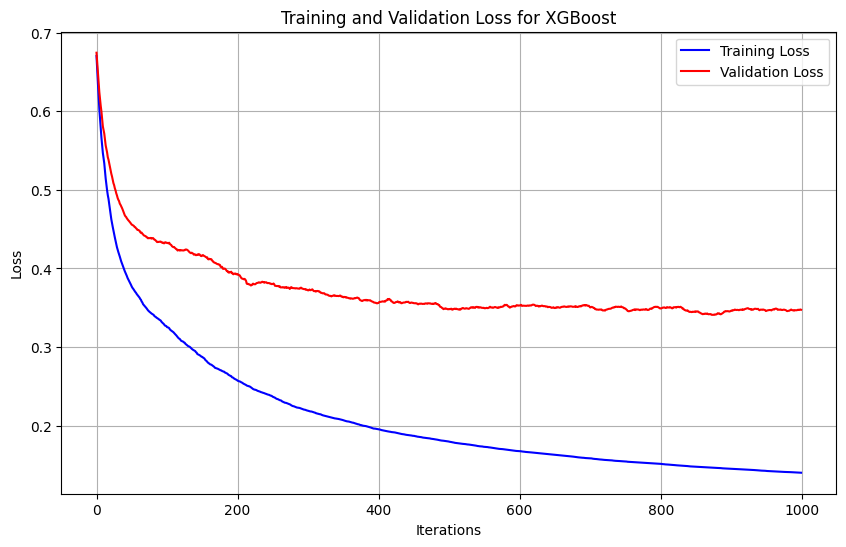

In [70]:
#  Print the best hyperparameters
print(f"\nBest hyperparameters for XGBoost: {xgb_cv_model.best_params_}\n")

# Get the best model with best parameters
best_xgb_model = xgb_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_xgb_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set
y_pred_xgb_encoded = best_xgb_model.predict(X_valid_scaled)

# Inverse transform predictions to original class labels
y_pred_xgb = label_encoder.inverse_transform(y_pred_xgb_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for XGBoost on the validation set:")
print(classification_report(y_valid_original, y_pred_xgb, zero_division=0))

# Plot Confusion Matrix
cm_valid_xgb = confusion_matrix(y_valid_original, y_pred_xgb)
plot_confusion_matrix(cm_valid_xgb, "XGBoost Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_xgb = best_xgb_model.predict_proba(X_valid_scaled)[:, 1]  
# Compute ROC curve
fpr_xgb, tpr_xgb, _ = roc_curve(y_valid_encoded, y_prob_xgb)

# Compute AUC using roc_auc_score
roc_auc_xgb = roc_auc_score(y_valid_encoded, y_prob_xgb)

# Plot ROC curve
plot_roc_curve(fpr_xgb, tpr_xgb, roc_auc_xgb, 'XGBoost')


# -------------------- Plot Loss --------------------

# Plot the training and validation loss curves
evals_result_xgb = best_xgb_model.evals_result()
plt.figure(figsize=(10, 6))
plt.plot(evals_result_xgb['validation_0']['logloss'], label='Training Loss', color='blue')
plt.plot(evals_result_xgb['validation_1']['logloss'], label='Validation Loss', color='red')
plt.title('Training and Validation Loss for XGBoost')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

##### LightGBM Classifier 

In [71]:
# Define the LightGBM model
lgbm_model = LGBMClassifier()

# Define the parameter distribution for RandomizedSearchCV
lgbm_params = {
    "learning_rate": [0.01, 0.05, 0.1, 0.2, 0.3],
    "n_estimators": [100, 200, 300], 
    "max_depth": [-1, 3, 4],
    "subsample": [0.8, 0.9, 1.0],  
    "min_child_samples": [15, 20, 25, 30], 
    "random_state": [SEED]
}

# Set up cross-validation strategy
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=5, random_state=SEED)

# Set up RandomizedSearchCV
lgbm_cv_model = RandomizedSearchCV(estimator=lgbm_model,
                                   param_distributions=lgbm_params,
                                   n_iter=20,  
                                   n_jobs=None,  
                                   cv=cv,      
                                   random_state=SEED)  

# Set the early_stopping
callbacks_lgbm = [early_stopping(stopping_rounds=20, verbose=False)]

# Fit the model using RandomizedSearchCV
lgbm_cv_model.fit(X_train_scaled, y_train_encoded, 
                  eval_set=[(X_train_scaled, y_train_encoded), (X_valid_scaled, y_valid_encoded)],
                  eval_metric='multi_logloss',
                  callbacks=callbacks_lgbm
                  )  

[LightGBM] [Info] Number of positive: 411, number of negative: 411
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 156
[LightGBM] [Info] Number of data points in the train set: 822, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

RandomizedSearchCV(cv=RepeatedStratifiedKFold(n_repeats=5, n_splits=10, random_state=5),
                   estimator=LGBMClassifier(), n_iter=20,
                   param_distributions={'learning_rate': [0.01, 0.05, 0.1, 0.2,
                                                          0.3],
                                        'max_depth': [-1, 3, 4],
                                        'min_child_samples': [15, 20, 25, 30],
                                        'n_estimators': [100, 200, 300],
                                        'random_state': [5],
                                        'subsample': [0.8, 0.9, 1.0]},
                   random_state=5)


Best hyperparameters for LightGBM: {'subsample': 1.0, 'random_state': 5, 'n_estimators': 100, 'min_child_samples': 20, 'max_depth': -1, 'learning_rate': 0.3}

Training accuracy: 0.95

Classification report for LightGBM on the validation set:
               precision    recall  f1-score   support

elevated risk       0.90      0.90      0.90        52
     low risk       0.86      0.86      0.86        35

     accuracy                           0.89        87
    macro avg       0.88      0.88      0.88        87
 weighted avg       0.89      0.89      0.89        87



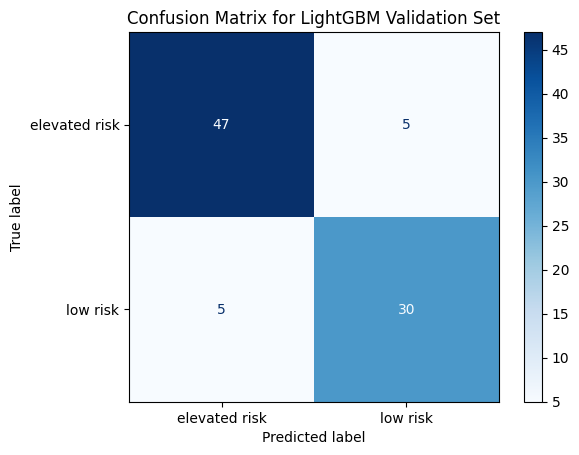

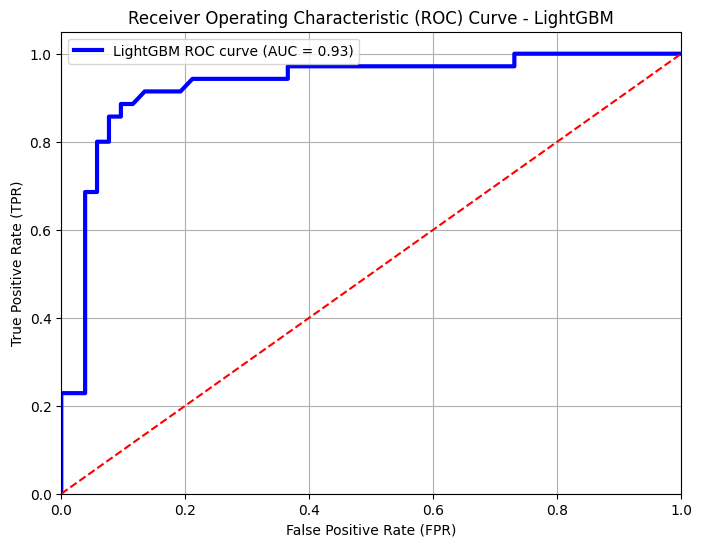

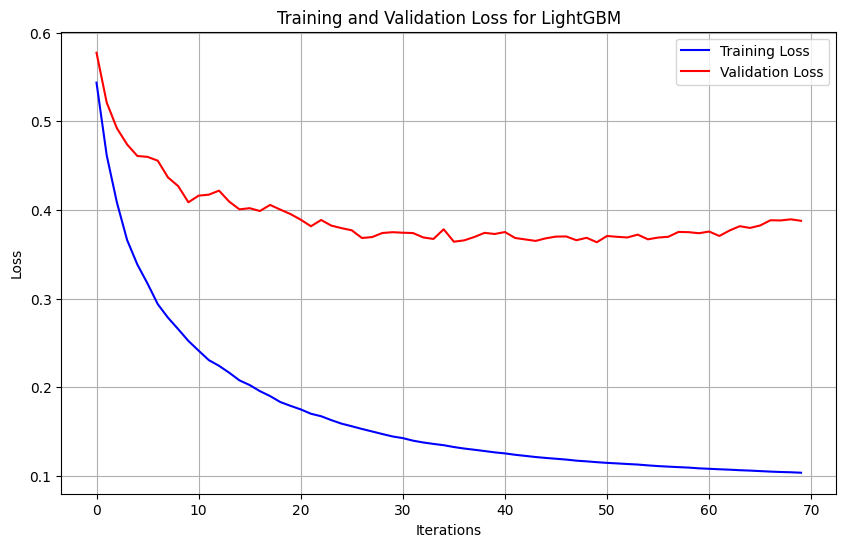

In [72]:
# Print the best hyperparameters
print(f"\nBest hyperparameters for LightGBM: {lgbm_cv_model.best_params_}\n")

# Get the best model with best parameters
best_lgbm_model = lgbm_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_lgbm_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set
y_pred_lgbm_encoded = best_lgbm_model.predict(X_valid_scaled)

# Inverse transform predictions to original class labels
y_pred_lgbm = label_encoder.inverse_transform(y_pred_lgbm_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for LightGBM on the validation set:")
print(classification_report(y_valid_original, y_pred_lgbm, zero_division=0))

# Plot Confusion Matrix
cm_valid_lgbm = confusion_matrix(y_valid_original, y_pred_lgbm)
plot_confusion_matrix(cm_valid_lgbm, "LightGBM Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_lgbm = best_lgbm_model.predict_proba(X_valid_scaled)[:, 1]  
# Compute ROC curve
fpr_lgbm, tpr_lgbm, _ = roc_curve(y_valid_encoded, y_prob_lgbm)

# Compute AUC using roc_auc_score
roc_auc_lgbm = roc_auc_score(y_valid_encoded, y_prob_lgbm)

# Plot ROC curve
plot_roc_curve(fpr_lgbm, tpr_lgbm, roc_auc_lgbm, 'LightGBM')


# -------------------- Plot Loss --------------------


# Access the evaluation results for plotting
evals_result_lgbm = best_lgbm_model.evals_result_

# Plot the training and validation loss curves
plt.figure(figsize=(10, 6))
plt.plot(evals_result_lgbm['training']['binary_logloss'], label='Training Loss', color='blue')
plt.plot(evals_result_lgbm['valid_1']['binary_logloss'], label='Validation Loss', color='red')
plt.title('Training and Validation Loss for LightGBM')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

##### CatBoost Classifier 

In [73]:
# Define the CatBoost model
cat_model = CatBoostClassifier(silent=True)  # Set silent=True to suppress verbose output during training

# Define the parameter grid for RandomizedSearchCV
cat_params = {
    "iterations": [100, 200, 300, 500, 1000],         
    "learning_rate": [0.001, 0.01, 0.1, 0.2, 0.5, 1.],   
    "max_depth": [3, 4, 5, 6, 7, 8],                  
    "l2_leaf_reg": [1, 3, 5, 10, 15],                
    "loss_function": ["MultiClass"],                   
    "early_stopping_rounds": [50, 100, 150],         
    "random_seed": [SEED],                             
    "eval_metric": ["MultiClass"],                    
    "bootstrap_type": ["Bernoulli", "Bayesian"],      
    "metric_period": [50, 100],                       
}


# Set up cross-validation strategy
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=SEED)

# Set up RandomizedSearchCV with a number of iterations to sample
cat_cv_model = RandomizedSearchCV(estimator=cat_model,
                                  param_distributions=cat_params,
                                  n_iter=20,              
                                  n_jobs=-1,               
                                  cv=cv,                  
                                  random_state=SEED,         
                                  )              


# Fit the model and track the evaluation metrics
cat_cv_model.fit(
    X_train_scaled, y_train_encoded,  
    eval_set = (X_valid_scaled, y_valid_encoded),             
    early_stopping_rounds=30         
)


RandomizedSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=5),
                   estimator=<catboost.core.CatBoostClassifier object at 0x799bd4a1bfe0>,
                   n_iter=20, n_jobs=-1,
                   param_distributions={'bootstrap_type': ['Bernoulli',
                                                           'Bayesian'],
                                        'early_stopping_rounds': [50, 100, 150],
                                        'eval_metric': ['MultiClass'],
                                        'iterations': [100, 200, 300, 500,
                                                       1000],
                                        'l2_leaf_reg': [1, 3, 5, 10, 15],
                                        'learning_rate': [0.001, 0.01, 0.1, 0.2,
                                                          0.5, 1.0],
                                        'loss_function': ['MultiClass'],
                                        'max_depth': [3, 4, 5, 6, 7, 8],
                                        'metric_period': [50, 100],
                                        'random_seed': [5]},
                   random_state=5)


Best hyperparameters for CatBoost: {'random_seed': 5, 'metric_period': 100, 'max_depth': 7, 'loss_function': 'MultiClass', 'learning_rate': 0.2, 'l2_leaf_reg': 3, 'iterations': 500, 'eval_metric': 'MultiClass', 'early_stopping_rounds': 100, 'bootstrap_type': 'Bayesian'}

Training accuracy: 0.95

Classification report for CatBoost on the validtaion set:
               precision    recall  f1-score   support

elevated risk       0.89      0.94      0.92        52
     low risk       0.91      0.83      0.87        35

     accuracy                           0.90        87
    macro avg       0.90      0.89      0.89        87
 weighted avg       0.90      0.90      0.90        87



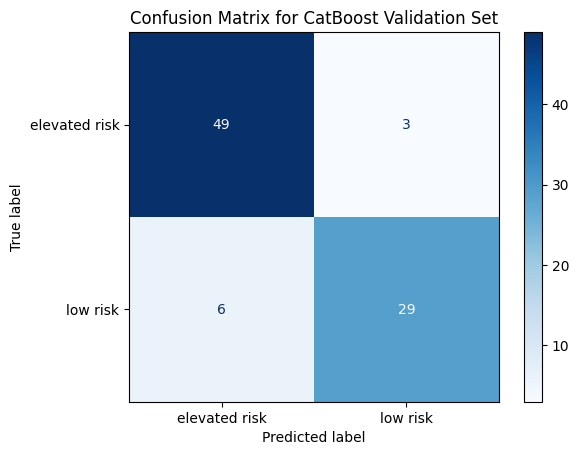

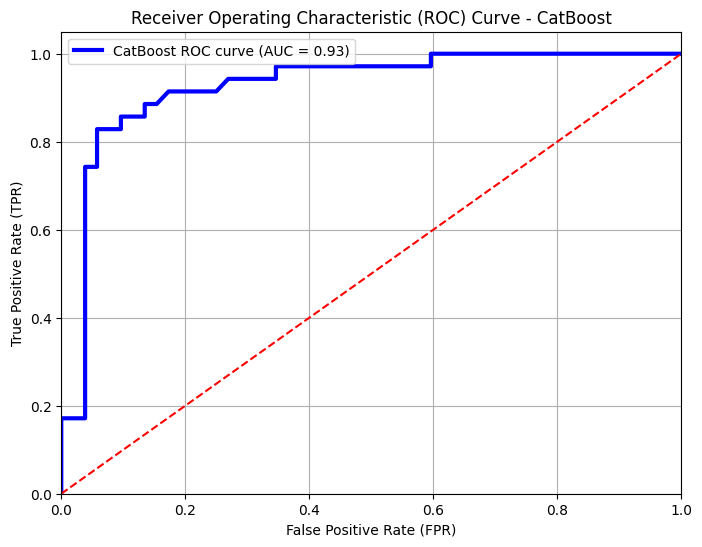

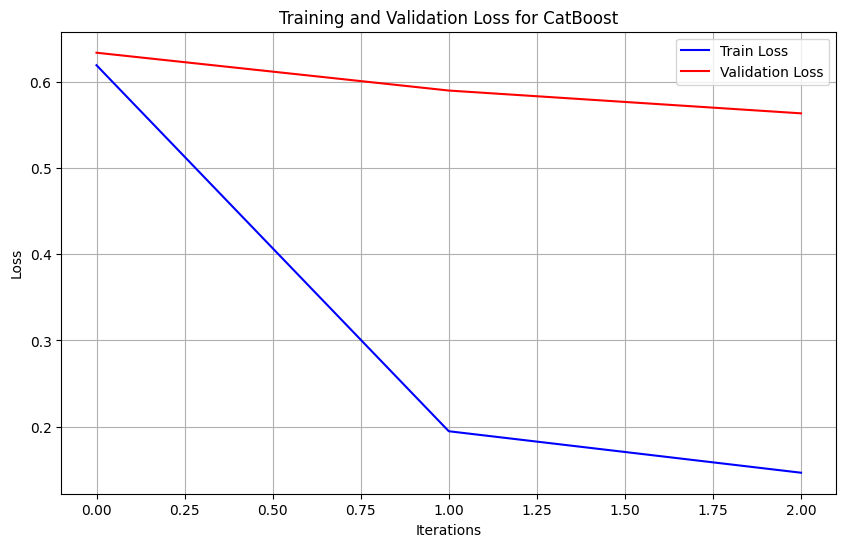

In [74]:
# Print the best hyperparameters
print(f"\nBest hyperparameters for CatBoost: {cat_cv_model.best_params_}\n")

# Get the best model with best parameters
best_cat_model = cat_cv_model.best_estimator_

# Evaluate accuracy on the training set using best model
print(f"Training accuracy: {best_cat_model.score(X_train_scaled, y_train_encoded):.2f}\n")

# Evaluate on the validation set
y_pred_cat_encoded = best_cat_model.predict(X_valid_scaled)

# # Inverse transform predictions to original class labels
y_pred_cat = label_encoder.inverse_transform(y_pred_cat_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Print the classification report for the validation set
print("Classification report for CatBoost on the validtaion set:")
print(classification_report(y_valid_original, y_pred_cat, zero_division=0))


# Plot Confusion Matrix
cm_valid_cat = confusion_matrix(y_valid_original, y_pred_cat)
plot_confusion_matrix(cm_valid_cat, "CatBoost Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_cat = best_cat_model.predict_proba(X_valid_scaled)[:, 1]  
# Compute ROC curve
fpr_cat, tpr_cat, _ = roc_curve(y_valid_encoded, y_prob_cat)

# Compute AUC using roc_auc_score
roc_auc_cat = roc_auc_score(y_valid_encoded, y_prob_cat)

# Plot ROC curve
plot_roc_curve(fpr_cat, tpr_cat, roc_auc_cat, 'CatBoost')


# -------------------- Plot Loss --------------------

# Get the evaluation results
evals_result_cat = best_cat_model.get_evals_result()

# Extracting the training and validation loss from the result
train_loss = best_cat_model.get_evals_result()['learn']['MultiClass']
validation_loss = best_cat_model.get_evals_result()['validation']['MultiClass']

# Ensure both lists have the same length by trimming the longer one
min_len = min(len(train_loss), len(validation_loss))

# Plot training and validation log loss
plt.figure(figsize=(10, 6))
plt.plot(train_loss[:min_len], label='Train Loss', color='blue')
plt.plot(validation_loss[:min_len], label='Validation Loss', color='red')
plt.title('Training and Validation Loss for CatBoost')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

### Models Comparaison with AUC - ROC

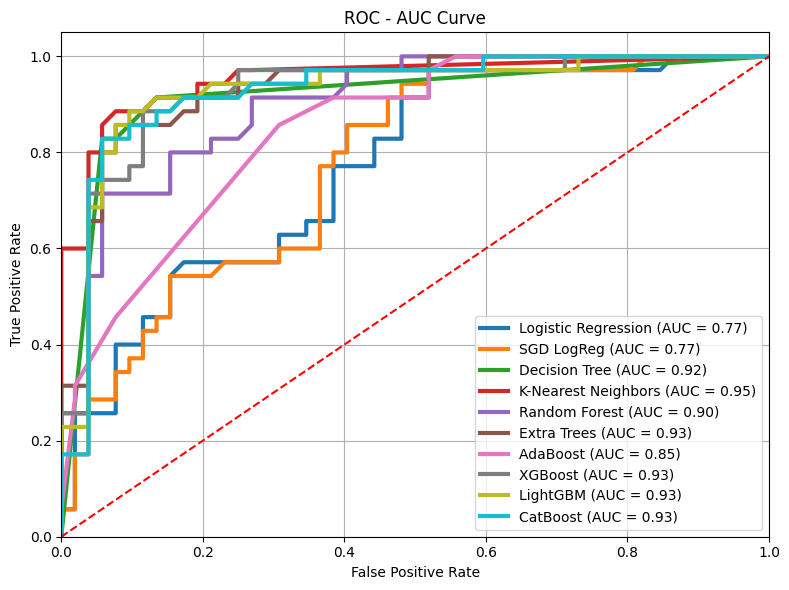

In [75]:
# Create the models dictionary
models_roc_data = {
    'Logistic Regression': (fpr_logr, tpr_logr, roc_auc_logr),
    'SGD LogReg': (fpr_sgd, tpr_sgd, roc_auc_sgd),
    'Decision Tree': (fpr_dt, tpr_dt, roc_auc_dt),
    'K-Nearest Neighbors': (fpr_knn, tpr_knn, roc_auc_knn),
    'Random Forest': (fpr_rf, tpr_rf, roc_auc_rf),
    'Extra Trees': (fpr_et, tpr_et, roc_auc_et),
    'AdaBoost': (fpr_ada, tpr_ada, roc_auc_ada),
    'XGBoost': (fpr_xgb, tpr_xgb, roc_auc_xgb),
    'LightGBM': (fpr_lgbm, tpr_lgbm, roc_auc_lgbm),
    'CatBoost': (fpr_cat, tpr_cat, roc_auc_cat)
}


# Call the plotting function
plot_multiple_roc_curves(models_roc_data)

#### Stacking and Voting

In [76]:
# Select models based on performance and use the best parameters from cross-validation
base_learners = [
    ('Decision Tree', best_dt_model),
    ('K-Nearest Neighbors', best_knn_model), 
    ('Random Forest', best_rf_model), 
    ('Extra Trees', best_et_model),
    ('XGBoost', best_xgb_model), 
    ('LightGBM', best_lgbm_model), 
    ('CatBoost', best_cat_model)  
]

# Create Stacking model
meta_model = LogisticRegression()
stacking_model = StackingClassifier(estimators=base_learners, final_estimator=meta_model)

# Create VotingClassifier (soft voting)
voting_model = VotingClassifier(estimators=base_learners, voting='soft') # votin = 'hard' or 'soft"

# Fit and evaluate performance
stacking_model.fit(X_train_scaled, y_train_encoded)
voting_model.fit(X_train_scaled, y_train_encoded)


[LightGBM] [Info] Number of positive: 457, number of negative: 457
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 162
[LightGBM] [Info] Number of data points in the train set: 914, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

VotingClassifier(estimators=[('Decision Tree',
                              DecisionTreeClassifier(max_depth=30,
                                                     random_state=5)),
                             ('K-Nearest Neighbors',
                              KNeighborsClassifier(algorithm='ball_tree',
                                                   leaf_size=20,
                                                   metric='euclidean',
                                                   n_neighbors=31, p=1,
                                                   weights='distance')),
                             ('Random Forest',
                              RandomForestClassifier(class_weight='balanced',
                                                     criterion='entropy',
                                                     max_depth=50,
                                                     max_features=None,
                                                     m...
                                            max_cat_to_onehot=None,
                                            max_delta_step=None, max_depth=4,
                                            max_leaves=None,
                                            min_child_weight=None, missing=nan,
                                            monotone_constraints=None,
                                            multi_strategy=None,
                                            n_estimators=1000, n_jobs=None,
                                            num_parallel_tree=None,
                                            random_state=5, ...)),
                             ('LightGBM',
                              LGBMClassifier(learning_rate=0.3,
                                             random_state=5)),
                             ('CatBoost',
                              <catboost.core.CatBoostClassifier object at 0x799bd4a76210>)],
                 voting='soft')

Stacking Model - Train Accuracy: 0.95

Classification report for Stacking Model on the validation set:
               precision    recall  f1-score   support

elevated risk       0.91      0.92      0.91        52
     low risk       0.88      0.86      0.87        35

     accuracy                           0.90        87
    macro avg       0.89      0.89      0.89        87
 weighted avg       0.90      0.90      0.90        87



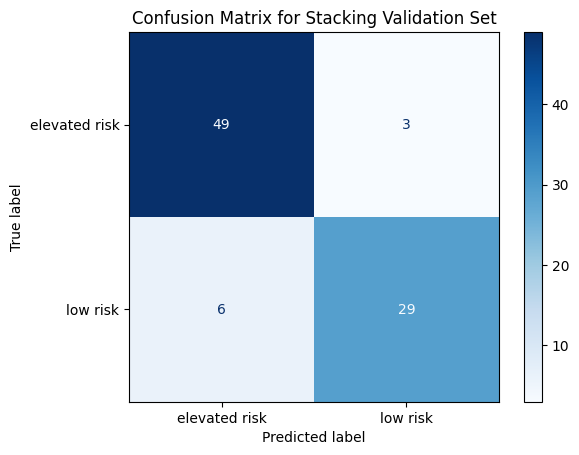

Voting Model - Train Accuracy: 0.95

Classification report for Voting Model on the validation set:
               precision    recall  f1-score   support

elevated risk       0.91      0.92      0.91        52
     low risk       0.88      0.86      0.87        35

     accuracy                           0.90        87
    macro avg       0.89      0.89      0.89        87
 weighted avg       0.90      0.90      0.90        87



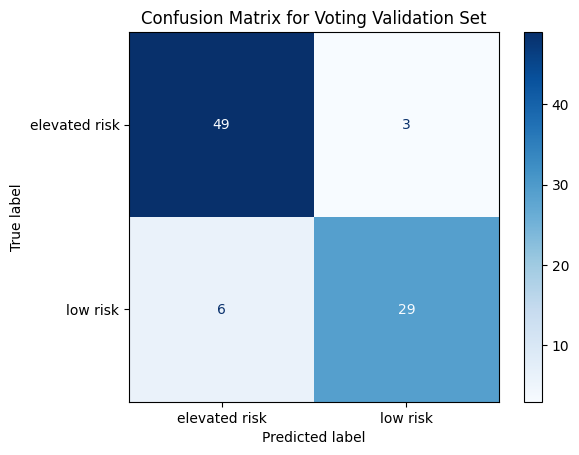

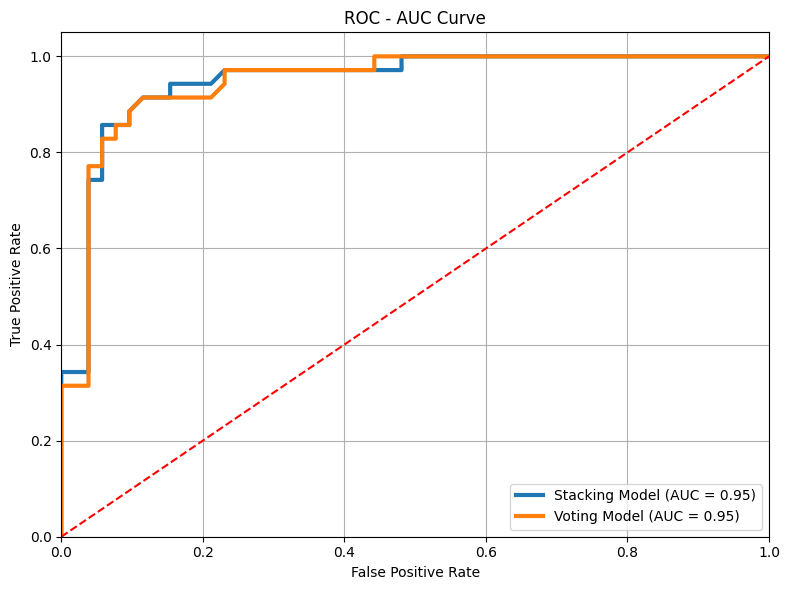

In [77]:
# Predictions
y_pred_stacking_encoded = stacking_model.predict(X_valid_scaled)
y_pred_voting_encoded = voting_model.predict(X_valid_scaled)

# # Inverse transform predictions to original class labels
y_pred_stacking = label_encoder.inverse_transform(y_pred_stacking_encoded)
y_pred_voting = label_encoder.inverse_transform(y_pred_voting_encoded)
y_valid_original = label_encoder.inverse_transform(y_valid_encoded)

# Evaluate accuracy of Stacking Model on the training set
print(f"Stacking Model - Train Accuracy: {accuracy_score(y_train_encoded, stacking_model.predict(X_train_scaled)):.2f}\n")
# Print the classification report for the validation set
print("Classification report for Stacking Model on the validation set:")
print(classification_report(y_valid_original, y_pred_stacking, zero_division=0))

# Plot Confusion Matrix for Stacking Model
cm_stacking = confusion_matrix(y_valid_original, y_pred_stacking)
plot_confusion_matrix(cm_valid_cat, "Stacking Validation")

# Evaluate accuracy of Voting Model on the training set
print(f"Voting Model - Train Accuracy: {accuracy_score(y_train_encoded, voting_model.predict(X_train_scaled)):.2f}\n")
# Print the classification report for the validation set
print("Classification report for Voting Model on the validation set:")
print(classification_report(y_valid_original, y_pred_voting, zero_division=0))

# Plot Confusion Matrix for Voting Model
cm_voting = confusion_matrix(y_valid_original, y_pred_voting)
plot_confusion_matrix(cm_valid_cat, "Voting Validation")


# -------------------- AUC-ROC --------------------

# Get the probability predictions (for ROC) - for the positive class
y_prob_stacking = stacking_model.predict_proba(X_valid_scaled)[:, 1] 
y_prob_voting = voting_model.predict_proba(X_valid_scaled)[:, 1]  
# Compute ROC curve
fpr_stacking, tpr_stacking, _ = roc_curve(y_valid_encoded, y_prob_stacking)
fpr_voting, tpr_voting, _ = roc_curve(y_valid_encoded, y_prob_voting)

# Compute AUC using roc_auc_score
roc_auc_stacking = roc_auc_score(y_valid_encoded, y_prob_stacking)
roc_auc_voting = roc_auc_score(y_valid_encoded, y_prob_voting)

# Create the models dictionary
models_roc_data = {
    'Stacking Model': (fpr_stacking, tpr_stacking, roc_auc_stacking),
    'Voting Model': (fpr_voting, tpr_voting, roc_auc_voting)
}

# Call the plotting function
plot_multiple_roc_curves(models_roc_data)


## Final Evaluation on Test Set

Classification report for K-Nearest Neighbors on the test set:
               precision    recall  f1-score   support

elevated risk       0.92      0.91      0.91        99
     low risk       0.84      0.85      0.84        54

     accuracy                           0.89       153
    macro avg       0.88      0.88      0.88       153
 weighted avg       0.89      0.89      0.89       153



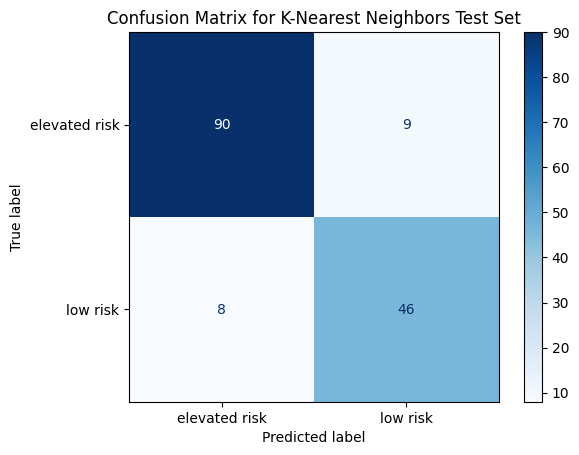

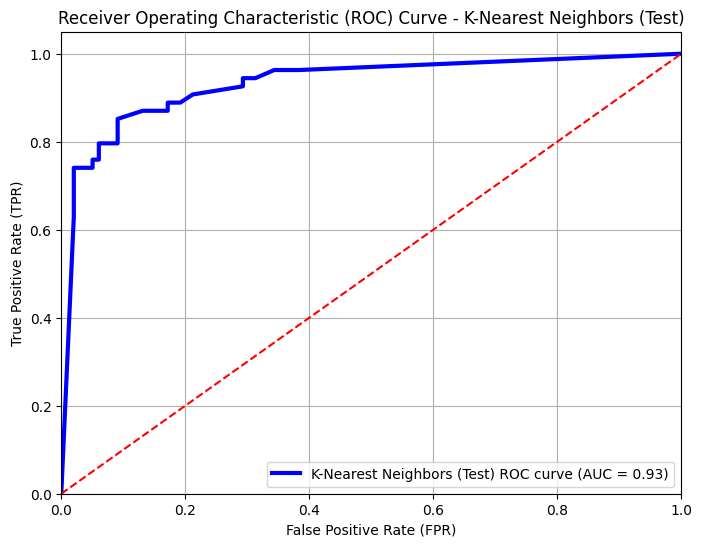

In [78]:
# Evaluate on the test set
y_pred_test_encoded = best_knn_model.predict(X_test_scaled)

# Inverse transform predictions to original class labels
y_pred_test = label_encoder.inverse_transform(y_pred_test_encoded)
y_test_original = label_encoder.inverse_transform(y_test_encoded)

# Print the classification report for K-Nearest Neighbors on the test set
print("Classification report for K-Nearest Neighbors on the test set:")
print(classification_report(y_test_original, y_pred_test, zero_division=0))

# Plot Confusion Matrix for test set
cm_test_knn = confusion_matrix(y_test_original, y_pred_test)
plot_confusion_matrix(cm_test_knn, "K-Nearest Neighbors Test")


# --------------- AUC-ROC for Test Set --------------------

# Get the probability predictions for the positive class on the test set
y_prob_test_knn = best_knn_model.predict_proba(X_test_scaled)[:, 1]  

# Compute ROC curve
fpr_test_knn, tpr_test_knn, _ = roc_curve(y_test_encoded, y_prob_test_knn)

# Compute AUC using roc_auc_score
roc_auc_test_knn = roc_auc_score(y_test_encoded, y_prob_test_knn)

# Plot ROC curve for test set
plot_roc_curve(fpr_test_knn, tpr_test_knn, roc_auc_test_knn, 'K-Nearest Neighbors (Test)')


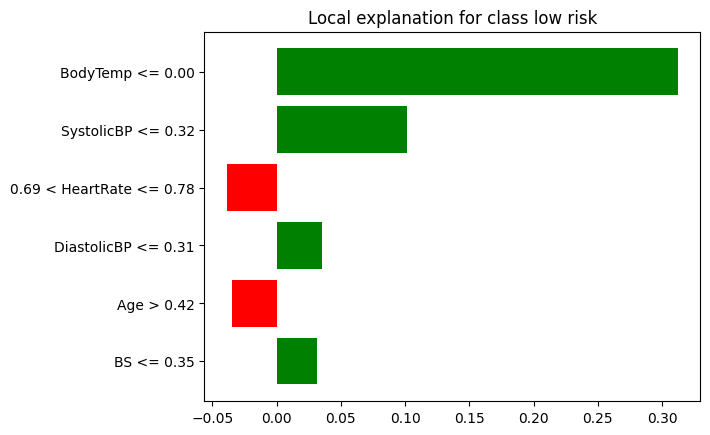

In [79]:
from lime.lime_tabular import LimeTabularExplainer
from sklearn.linear_model import LinearRegression

# Initialize LIME explainer with feature names and class names
explainer_knn = LimeTabularExplainer(X_train_scaled, 
                                     training_labels=y_train_encoded, 
                                     feature_names=X_train.columns, 
                                     class_names=label_encoder.classes_,
                                     mode="classification",
                                     random_state=SEED
                                     )

# Explain a prediction (for the first instance in the test set)
exp_knn = explainer_knn.explain_instance(X_test_scaled[11], 
                                         best_knn_model.predict_proba,
                                         model_regressor=LinearRegression())



# Get the explanation figure
fig = exp_knn.as_pyplot_figure()

# Show explanation in notebook
exp_knn.show_in_notebook()


For the particular instance provided:

- **BodyTemp, SystolicBP, DiastolicBP**, and **BS** are **positively contributing**, so they push the model's prediction toward **low risk**.
- **HeartRate** and **Age** are **negatively contributing**, so they push the model's prediction toward **elevated risk**.

In [80]:
# List to store explanations for all instances
explanations = []

# Iterate over all instances in the test set
for i in range(len(X_test_scaled)):
    # Get explanation for each instance
    exp = explainer_knn.explain_instance(X_test_scaled[i], best_knn_model.predict_proba)
    explanations.append(exp)
    

#------------ Aggregating Feature Importances ------------

# Create a matrix to store feature importances for all instances
all_feature_importances = np.zeros((len(X_test_scaled), len(X_train.columns)))

# Iterate over all explanations to extract feature importances
for i, exp in enumerate(explanations):
    # Get the feature importances for the current explanation as a list of tuples
    explanation_list = exp.as_list()

    # Extract only the importance values from the list of tuples
    for j, (feature, importance) in enumerate(explanation_list):
        all_feature_importances[i, j] = importance  

# Now, aggregate the feature importances across instances 
mean_feature_importance = np.mean(all_feature_importances, axis=0)

# Display the mean feature importance
print("Mean feature importance across all instances:\n")
for feature, importance in zip(X_train.columns, mean_feature_importance):
    print(f"{feature}: {importance}")


Mean feature importance across all instances:

Age: 0.19820081638461415
SystolicBP: -0.03800950358270944
DiastolicBP: 0.007457671436629072
BS: 0.014812741901041915
BodyTemp: 0.0009260907090779182
HeartRate: -0.007762851551781702


- **Age** is the **most important** factor, pushing the prediction more toward **low risk**.
- **SystolicBP, BodyTemp, HeartRate** have **small negative** effects, meaning they slightly push the prediction toward **elevated risk**.
- **DiastolicBP** and **BS** have **small positive** effects, pushing the prediction toward **low risk**.

# Observations

We implemented ten models, including Logistic Regression, SGD Classifier (for Logistic Regression), Decision Tree, K-Nearest Neighbors, Random Forest, Extra Trees, AdaBoost, XGBoost, LightGBM, and CatBoost. We also built stacking and voting models using some of the best-performing models.

Among these, **K-Nearest Neighbors** achieved the best performance on both the training and validation sets. It also made the fewest errors, as seen in the confusion matrix, and had the highest AUC score.

- Overall, the K-Nearest Neighbors model is performing very well on the test set, with **89% accuracy** and **0.93 AUC**.
- The **AUC of 0.93** on the test set is excellent, demonstrating the model's strong ability to distinguish between the elevated and lower-risk classes.
- While most of the features have relatively small effects, **Age** stands out as the most influential feature in determining the risk level of becoming **sick**.

# Key Points and Recommendations:

1. **Focus on Age:**
    - Younger mothers may need guidance on prenatal care.
    - Older mothers should have more frequent check-ups for issues like hypertension and gestational diabetes.

2. **Monitor BHealth Indicators:**
    - Regularly check **blood pressure, body temperature,** and **heart rate**.
    - If these values are elevated, investigate quickly to catch complications early.

3. **Encourage Healthy Blood Pressure and Sugar Levels:**
    - Mothers should maintain **healthy diastolic blood pressure** and **blood sugar** through good diet, exercise, and regular medical visits.
    - This can help prevent gestational hypertension and diabetes.